# Coursework 2: Generative Models

## Instructions

### Submission 
Please submit one zip file on cate - *CW2.zip* containing the following:
1. A version of this notebook containing your answers. Write your answers in the cells below each question. **Please deliver the notebook including the outputs of the cells**
2. Your trained VAE model as *VAE_model.pth*
3. Your trained Generator and Discriminator: *DCGAN_model_D.pth and DCGAN_model_G.pth*


### Training
Training the GAN will take quite a long time (multiple hours), please refer to the 4 GPU options detailed in the logistics lecture. Some additional useful pointers:
* PaperSpace [guide if you need more compute](https://hackmd.io/@afspies/S1stL8Qnt)
* Lab GPUs via SSH.  The VSCode Remote Develop extension is recommended for this. For general Imperial remote working instructions see [this post](https://www.doc.ic.ac.uk/~nuric/teaching/remote-working-for-imperial-computing-students.html). You'll also want to [setup your environment as outlined here](https://hackmd.io/@afspies/Bkd7Zq60K).
* Use Colab and add checkpointing to the model training code; this is to handle the case where colab stops a free-GPU kernel after a certain number of hours (~4).
* Use Colab Pro - If you do not wish to use PaperSpace then you can pay for Colab Pro. We cannot pay for this on your behalf (this is Google's fault).


### Testing
TAs will run a testing cell (at the end of this notebook), so you are required to copy your data ```transform``` and ```denorm``` functions to a cell near the bottom of the document (it is demarkated). You are advised to check that your implementations pass these tests (in particular, the jit saving and loading may not work for certain niche functions)

### General
You can feel free to add architectural alterations / custom functions outside of pre-defined code blocks, but if you manipulate the model's inputs in some way, please include the same code in the TA test cell, so our tests will run easily.

<font color="orange">**The deadline for submission is Monday, 26 Feb by 6 pm** </font>

## Setting up working environment
You will need to install pytorch and import some utilities by running the following cell:

In [22]:
!pip install -q torch torchvision altair==4.2.2 seaborn
!git clone -q https://github.com/afspies/icl_dl_cw2_utils
from icl_dl_cw2_utils.utils.plotting import plot_tsne
from pathlib import Path
import tqdm

fatal: destination path 'icl_dl_cw2_utils' already exists and is not an empty directory.


Here we have some default pathing options which vary depending on the environment you are using. You can of course change these as you please.

In [23]:
# Initialization Cell
WORKING_ENV = 'LABS' # Can be LABS, COLAB, PAPERSPACE, SAGEMAKER
USERNAME = 'kh123' # If working on Lab Machines - Your college username
assert WORKING_ENV in ['LABS', 'COLAB', 'PAPERSPACE', 'SAGEMAKER']

if WORKING_ENV == 'COLAB':
    from google.colab import drive
    %load_ext google.colab.data_table
    dl_cw2_repo_path = 'dl_cw2/' # path in your gdrive to the repo
    content_path = f'/content/drive/MyDrive/{dl_cw2_repo_path}' # path to gitrepo in gdrive after mounting
    data_path = './data/' # save the data locally
    drive.mount('/content/drive/') # Outputs will be saved in your google drive

elif WORKING_ENV == 'LABS':
    content_path = f'/vol/bitbucket/{USERNAME}/dl-cw2/' # You may want to change this
    data_path = f'/vol/bitbucket/{USERNAME}/dl/'
    # Your python env and training data should be on bitbucket
    if 'vol/bitbucket' not in content_path or 'vol/bitbucket' not in data_path:
        import warnings
        warnings.warn(
           'It is best to create a dir in /vol/bitbucket/ otherwise you will quickly run into memory issues'
           )
elif WORKING_ENV == 'PAPERSPACE': # Using Paperspace
    # Paperspace does not properly render animated progress bars
    # Strongly recommend using the JupyterLab UI instead of theirs
    !pip install ipywidgets
    content_path = '/notebooks/'
    data_path = './data/'
    
elif WORKING_ENV == 'SAGEMAKER':
    content_path = '/home/studio-lab-user/sagemaker-studiolab-notebooks/dl/'
    data_path = f'{content_path}x/'

else:
  raise NotImplementedError()

content_path = Path(content_path)

## Introduction

For this coursework, you are asked to implement two commonly used generative models:
1. A **Variational Autoencoder (VAE)**
2. A **Deep Convolutional Generative Adversarial Network (DCGAN)**

For the first part you will the MNIST dataset https://en.wikipedia.org/wiki/MNIST_database and for the second the CIFAR-10 (https://www.cs.toronto.edu/~kriz/cifar.html).

Each part is worth 50 points. 

The emphasis of both parts lies in understanding how the models behave and learn, however, some points will be available for getting good results with your GAN (though you should not spend too long on this).

# Part 1 - Variational Autoencoder

## Part 1.1 (25 points)
**Your Task:**

a. Implement the VAE architecture with accompanying hyperparameters. More marks are awarded for using a Convolutional Encoder and Decoder.

b. Design an appropriate loss function and train the model.


In [24]:
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
import torch.nn.functional as F
import matplotlib.pyplot as plt
import pandas as pd

def show(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)))

if not os.path.exists(content_path/'CW_VAE/'):
    os.makedirs(content_path/'CW_VAE/')

if not os.path.exists(data_path):
    os.makedirs(data_path)

# We set a random seed to ensure that your results are reproducible.
if torch.cuda.is_available():
    torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

GPU = True # Choose whether to use GPU
if GPU:
    device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")
else:
    device = torch.device("cpu")
print(f'Using {device}')

Using cuda


---
## Part 1.1a: Implement VAE (25 Points)
### Hyper-parameter selection


In [25]:
# Necessary Hyperparameters 
num_epochs = 20
learning_rate = 1e-3
batch_size = 128
latent_dim = 16

# Additional Hyperparameters 
beta = 0.9

# (Optionally) Modify transformations on input
transform = transforms.Compose([
    transforms.ToTensor(),
])

# (Optionally) Modify the network's output for visualizing your images
def denorm(x):
    return x

### Data loading


In [26]:
train_dat = datasets.MNIST(
    data_path, train=True, download=True, transform=transform
)
test_dat = datasets.MNIST(data_path, train=False, transform=transform)

loader_train = DataLoader(train_dat, batch_size, shuffle=True)
loader_test = DataLoader(test_dat, batch_size, shuffle=False)

# Don't change 
sample_inputs, _ = next(iter(loader_test))
fixed_input = sample_inputs[:32, :, :, :]
save_image(fixed_input, 'CW_VAE/image_original.png')

### Model Definition

<figure>
  <img src="https://blog.bayeslabs.co/assets/img/vae-gaussian.png" style="width:60%">
  <figcaption>
    Fig.1 - VAE Diagram (with a Guassian prior), taken from <a href="https://blog.bayeslabs.co/2019/06/04/All-you-need-to-know-about-Vae.html">1</a>.
  </figcaption>
</figure>


You will need to define:
* The hyperparameters
* The constructor
* encode
* reparametrize
* decode
* forward



Hints:
- It is common practice to encode the log of the variance, rather than the variance
- You might try using BatchNorm

In [27]:
# *CODE FOR PART 1.1a IN THIS CELL*

# Encoder Architecture
class Encoder(nn.Module):
    def __init__(self, latent_dim):
        super(Encoder, self).__init__()
        self.conv1 = nn.Conv2d(1, 16, 3)
        self.batch1 = nn.BatchNorm2d(16)
        self.conv2 = nn.Conv2d(16, 32, 3)
        self.batch2 = nn.BatchNorm2d(32)
        self.conv3 = nn.Conv2d(32, 64, 3)
        self.lin1 = nn.Linear(22*22*64, 128)
        self.lin2 = nn.Linear(128, 64)
        self.lin_mu = nn.Linear(64, latent_dim)
        self.lin_logvar = nn.Linear(64, latent_dim)
        
    def forward(self, x):
        x = x.to(device)
        x = F.relu(self.batch1(self.conv1(x)))
        x = F.relu(self.batch2(self.conv2(x)))
        x = F.relu(self.conv3(x))
        x = torch.flatten(x, start_dim=1)
        x = F.relu(self.lin1(x))
        x = F.relu(self.lin2(x))
        
        mu =  self.lin_mu(x)
        logvar = self.lin_logvar(x)
        
        return mu, logvar
        
# Decoder Architecture
class Decoder(nn.Module):
    def __init__(self, latent_dim):
        super(Decoder, self).__init__()
        self.lin1 = nn.Linear(latent_dim, 64)
        self.lin2 = nn.Linear(64, 128)
        self.lin3 = nn.Linear(128, 22*22*64)
        self.trans_conv1 = nn.ConvTranspose2d(64, 32, 3)
        self.trans_conv2 = nn.ConvTranspose2d(32, 16, 3)
        self.trans_conv3 = nn.ConvTranspose2d(16, 1, 3)
        
    def forward(self, z):
        z = F.relu(self.lin1(z))
        z = F.relu(self.lin2(z))
        z = F.relu(self.lin3(z))
        z = z.view(-1, 64, 22, 22) #Unflatten the input 
        z = F.relu(self.trans_conv1(z))
        z = F.relu(self.trans_conv2(z))
        z = self.trans_conv3(z)
        reconstruction = torch.sigmoid(z)
        
        return reconstruction

# VAE Architecture
class VAE(nn.Module):
    def __init__(self, latent_dim):
        super(VAE, self).__init__()
        self.encoder = Encoder(latent_dim)
        self.decoder = Decoder(latent_dim)
        
    def encode(self, x):
        mu, logvar = self.encoder(x)
        return mu, logvar

    def reparametrize(self, mu, logvar):
        std = torch.exp(logvar / 2) 
        epsilon = torch.randn_like(std)
        z = mu + epsilon * std
        return z

    def decode(self, z):
        reconstruction = self.decoder(z)
        return reconstruction
    
    def forward(self, x):
        
        mu, logvar = self.encode(x)
        z = self.reparametrize(mu, logvar)
        reconstruction = self.decode(z)
        
        return reconstruction, mu, logvar


model = VAE(latent_dim).to(device)
params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of parameters is: {}".format(params))
print(model)
print(model.parameters())
# optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

Total number of parameters is: 8027329
VAE(
  (encoder): Encoder(
    (conv1): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1))
    (batch1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv2): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1))
    (batch2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (conv3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
    (lin1): Linear(in_features=30976, out_features=128, bias=True)
    (lin2): Linear(in_features=128, out_features=64, bias=True)
    (lin_mu): Linear(in_features=64, out_features=16, bias=True)
    (lin_logvar): Linear(in_features=64, out_features=16, bias=True)
  )
  (decoder): Decoder(
    (lin1): Linear(in_features=16, out_features=64, bias=True)
    (lin2): Linear(in_features=64, out_features=128, bias=True)
    (lin3): Linear(in_features=128, out_features=30976, bias=True)
    (trans_conv1): ConvTranspose2d(64, 32, kernel_size=(3, 3), stride=(1,

--- 

## Part 1.1b: Training the Model (5 Points)

### Defining a Loss
Recall the Beta VAE loss, with an encoder $q$ and decoder $p$:
$$ \mathcal{L}=\mathbb{E}_{q_\phi(z \mid X)}[\log p_\theta(X \mid z)]-\beta D_{K L}[q_\phi(z \mid X) \| p_\theta(z)]$$

In order to implement this loss you will need to think carefully about your model's outputs and the choice of prior.

There are multiple accepted solutions. Explain your design choices based on the assumptions you make regarding the distribution of your data.

* Hint: this refers to the log likelihood as mentioned in the tutorial. Make sure these assumptions reflect on the values of your input data, i.e. depending on your choice you might need to do a simple preprocessing step.

* You are encouraged to experiment with the weighting coefficient $\beta$ and observe how it affects your training

### Defining a Loss Function and Train/Test Functions

In [20]:
# *CODE FOR PART 1.1b IN THIS CELL*

# Define VAE loss function
def loss_function_VAE(recon_x, x, mu, logvar, beta):
    
    recon_loss = F.mse_loss(recon_x, x, reduction='sum') # reconstruction loss (MSE, not maximum likelihood)
    kld_loss = torch.sum(torch.exp(logvar) + mu**2 - logvar - 1.0) / 2 # Kullback-Lieber divergence loss
    loss = recon_loss + beta*kld_loss # total loss

    return kld_loss, recon_loss, loss

# Define model training function for 1 epoch
def train_for_1_epoch(model, loader_train, optimizer, beta, currrent_epoch):
    model.train()

    # initialise the running loss
    total_loss = 0
    total_kld_loss = 0
    total_recon_loss = 0
        
    with tqdm.tqdm(loader_train, unit="batch") as tepoch: 
        for batch_idx, (data, _) in enumerate(tepoch):   
            
            x = data.to(device)

            data = data # Need at least one batch/random data with right shape -
                        # This is required to initialize to model properly below
                        # when we save the computational graph for testing (jit.save)

            # forward pass and loss calculation
            reconstruction, mu, logvar= model.forward(x)
            kld_loss, recon_loss, loss = loss_function_VAE(reconstruction, x, mu, logvar, beta)

            # divide the loss by the batch size to get the average loss per sample
            batch_size = x.shape[0]
            
            total_loss += loss.item() / batch_size
            total_kld_loss += kld_loss.item() / batch_size
            total_recon_loss += recon_loss.item() / batch_size
            
            # backpropagate and update parameters
            optimizer.zero_grad() 
            loss.backward()
            optimizer.step()

            if batch_idx % 20 == 0:
                tepoch.set_description(f"Epoch {currrent_epoch}")
                tepoch.set_postfix(loss=loss.item()/len(x))
        
        total_kld_loss /= len(loader_train.dataset)
        total_loss /= len(loader_train.dataset)
        total_recon_loss /= len(loader_train.dataset)
        
        return total_kld_loss, total_recon_loss, total_loss, data

# Define model testing function for 1 epoch
def test_for_1_epoch(model, loader_test, beta, currrent_epoch):
    model.eval()
    
    # initialise the running loss
    total_loss = 0
    total_kld_loss = 0
    total_recon_loss = 0

    with tqdm.tqdm(loader_test, unit="batch") as tepoch: 
        for batch_idx, (data, _) in enumerate(tepoch):
            
            x = data.to(device)

            # forward pass and loss calculation
            reconstruction, mu, logvar= model.forward(x)
            kld_loss, recon_loss, loss = loss_function_VAE(reconstruction, x, mu, logvar, beta)

            # divide the loss by the batch size to get the average loss per sample
            batch_size = x.shape[0]
            
            total_loss += loss.item() / batch_size
            total_kld_loss += kld_loss.item() / batch_size
            total_recon_loss += recon_loss.item() / batch_size
            
            if batch_idx % 20 == 0:
                tepoch.set_description(f"Epoch {currrent_epoch}")
                tepoch.set_postfix(loss=loss.item()/len(x))
        
        total_kld_loss /= len(loader_test.dataset)
        total_loss /= len(loader_test.dataset)
        total_recon_loss /= len(loader_test.dataset)
        
        return total_kld_loss, total_recon_loss, total_loss

# Define train-test loop function for multiple epochs
def train_test_loop(model, loader_train, loader_test, optimizer, beta, num_epochs):
    
    model = VAE(latent_dim).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
    
    train_kld_loss = []
    train_recon_loss = []
    train_total_loss = []
    test_kld_loss = []
    test_recon_loss = []
    test_total_loss = []
    
    for epoch in range(num_epochs):
        # train the model for 1 epoch
        kld_loss, recon_loss, total_loss, data = train_for_1_epoch(model, loader_train, optimizer, beta, epoch)
        train_kld_loss.append(kld_loss)
        train_recon_loss.append(recon_loss)
        train_total_loss.append(total_loss)
        
        # test the model for 1 epoch
        kld_loss, recon_loss, total_loss = test_for_1_epoch(model, loader_test, beta, epoch)
        test_kld_loss.append(kld_loss)
        test_recon_loss.append(recon_loss)
        test_total_loss.append(total_loss)
    
    dataframe = pd.DataFrame({
        'train_kld_loss': train_kld_loss,
        'train_recon_loss': train_recon_loss,
        'train_total_loss': train_total_loss,
        'test_kld_loss': test_kld_loss,
        'test_recon_loss': test_recon_loss,
        'test_total_loss': test_total_loss
    })
    
    current_directory = os.getcwd()
    print("Current directory:", current_directory)
    
    dataframe.to_csv(f'train-test losses/train-test losses for b={beta}.csv', index=False)
        
    # save the model
    with torch.no_grad():
        torch.save(model, f'{current_directory}/CW_VAE/VAE_model_beta_{beta}.pt')
    
    ### original save model code, didn't allow for reloading
    with torch.no_grad():
        torch.jit.save(torch.jit.trace(model, (data), check_trace=False),
            content_path/f'CW_VAE/VAE_model_beta_{beta}.pth')
            
            
    return model, train_kld_loss, train_recon_loss, train_total_loss, test_kld_loss, test_recon_loss, test_total_loss


### Training/Test Loop

In [28]:
# Run train test loop
beta_list = [1]
for beta in beta_list:
    model, _, _, _, _, _, _ =train_test_loop(model, loader_train, loader_test, optimizer, beta, 20)

Epoch 0:  79%|███████▉  | 371/469 [00:06<00:01, 61.81batch/s, loss=47.1]

Epoch 19: 100%|██████████| 79/79 [00:01<00:00, 77.48batch/s, loss=31.4]


Current directory: /vol/bitbucket/kh123/dl-cw2


### Loss Explanation
Explain your choice of loss and how this relates to:

* The VAE Prior
* The output data domain
* Disentanglement in the latent space


**YOUR ANSWER**

The loss function was chosen with consideration to its components: the KL divergence loss and the reconstruction loss. The factors of these component losses are described below.

*The VAE prior: Gaussian Distribution*

The KL divergence loss is directly affected by the VAE prior as it measures the discrepancy between the learned variational distribution $q_\phi(z \mid X)$ and the prior distribution $ p_\theta(z)$. Ultimately, the prior was chosen to be a Gaussian distribution as it offers several advantages: analytical simplicity, regularisation, and interpretability. Firstly, Gaussian distributions are simple and mathematically tractable, having well-defined properties and being useful in facilitating efficient computation. This selection also allows for a closed-form solution for the KL divergence to be derived. When analysing the loss function, the KL divergence is represented by $D_{K L}[q_\phi(z \mid X) \| p_\theta(z)]$, while $q_\phi(z \mid X)= N (z; \mu_{\phi}(x), diag(\sigma^2_\phi(x)))$. If $p_{\theta}(z)$ is assumed to take the form of $N(0,I)$, then the KL divergence can be expressed as $-D_{K L}[q_\phi(z \mid X) \| p_\theta(z)] = \frac{1}{2}\sum_{j=1}^J (1+ log(\sigma_j^2)-(\mu_j)^2-(\sigma_j)^2)$. This expression is used to calculate the KL loss within the code above. While the choice of prior distribution relies on specific data characteristics and modelling objectives, the Gaussian prior stands out as a logical starting point, offering simplicity, regularisation benefits, and interpretability, all in alignment with standard ML practices.

Furthermore, Gaussian priors provide a regularisation effect on the latent space, promoting smooth and continuous distributions. This regularisation helps guard against overfitting, enhancing the model's ability to generalize to unseen data. Lastly, the interpretability of parameters such as mean, and variance enhances the understanding of learned latent representations. This clarity aids in comprehending the central tendency and uncertainty within the latent space.

*The Output Data Domain: Continuous from 0 to 1*

The reconstruction error needs to consider the output data domain as it measures how closely input images ${x}$ resemble the reconstructed images $\hat{x}$. As the output data domain (images) are greyscale pixels, a continuous range of [0, 1], the mean squared error is used instead of binary cross entropy as the reconstruction loss metric. While each pixel is technically represented as a continuous number, images are comprised of highly contrasting light and dark pixels, being close to 0 or 1. As such, a final sigmoid layer can be applied, pushing reconstructed pixel values close to 0 or 1 while maintaining a continuous [0, 1] range. 

*Disentanglement of the Latent Space: Using Beta*

Disentanglement in VAEs refers to the latent space's ability to represent independent and interpretable factors of variation in the data. Within the latent space, each factor corresponds to a single underlying attribute, such as size or style. Disentangled representations are desirable as they facilitate better control and manipulation of data generation, enabling more meaningful transformations and interpretations. To optimise disentanglement, the importance of KL divergence is increased through the multiplication of the constant $\beta$. By increasing $\beta$, higher levels of disentanglement can be promoted. However, $\beta$ values at are too high can dominate the loss function, reducing the importance of the reconstruction loss to the point where the model is not incentivised to produce accurate outputs. High $\beta$ values also lead to increased computational complexity, especially for larger datasets and models. Considering this and multiple trials where beta was varied, $\beta = 1$ was selected as a good tradeoff between promoting disentanglement while still giving weight to the reconstruction loss. 


<h2>Part 1.2 (9 points)</h2>

a. Plot your loss curves

b. Show reconstructions and samples

c. Discuss your results from parts (a) and (b)

## Part 1.2a: Loss Curves (3 Points)
Plot your loss curves (6 in total, 3 for the training set and 3 for the test set): total loss, reconstruction log likelihood loss, KL loss (x-axis: epochs, y-axis: loss). If you experimented with different values of $\beta$, you may wish to display multiple plots (worth 1 point).

Loss curves for beta = 0


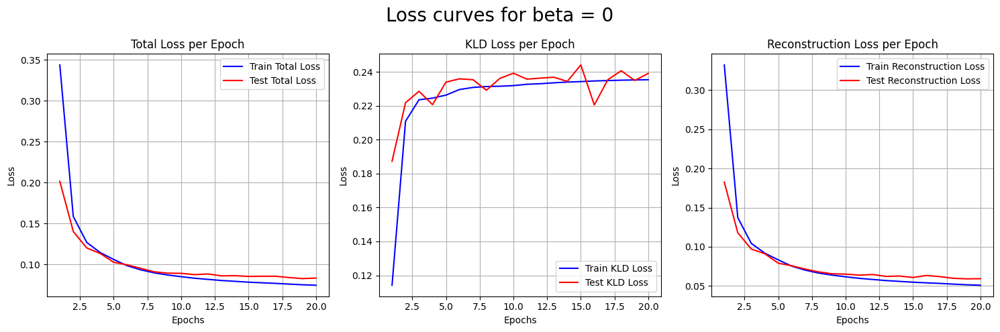

<Figure size 640x480 with 0 Axes>

Loss curves for beta = 0.5


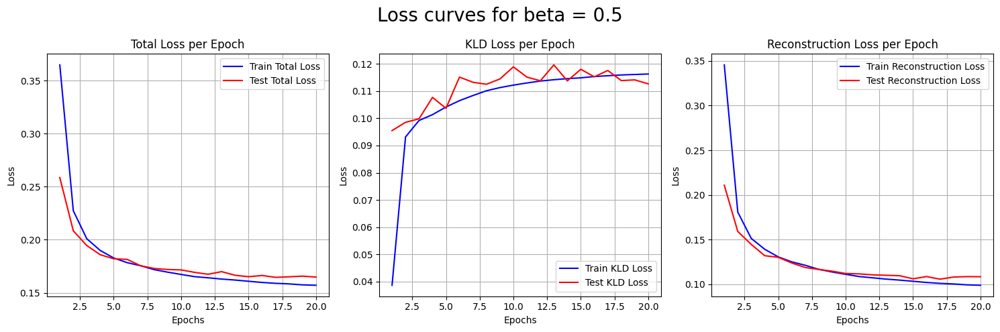

<Figure size 640x480 with 0 Axes>

Loss curves for beta = 1


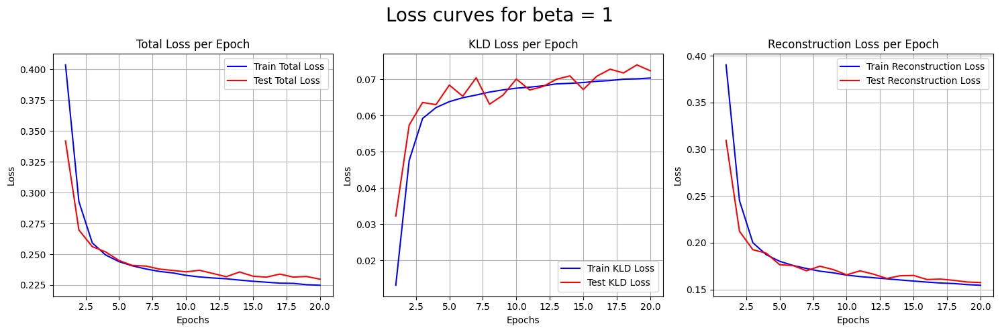

<Figure size 640x480 with 0 Axes>

Loss curves for beta = 2


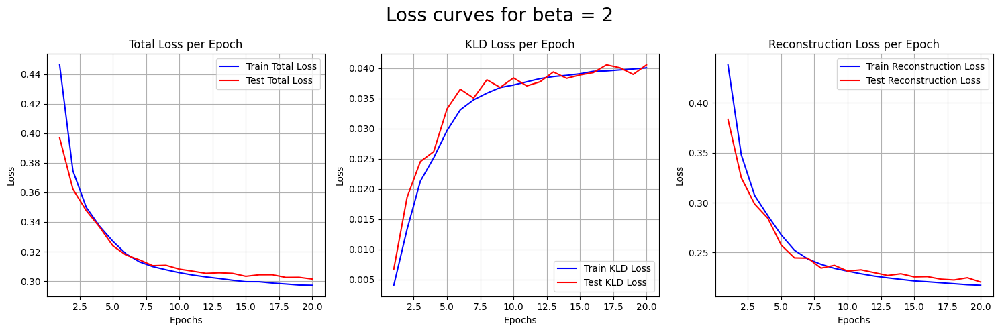

<Figure size 640x480 with 0 Axes>

Loss curves for beta = 5


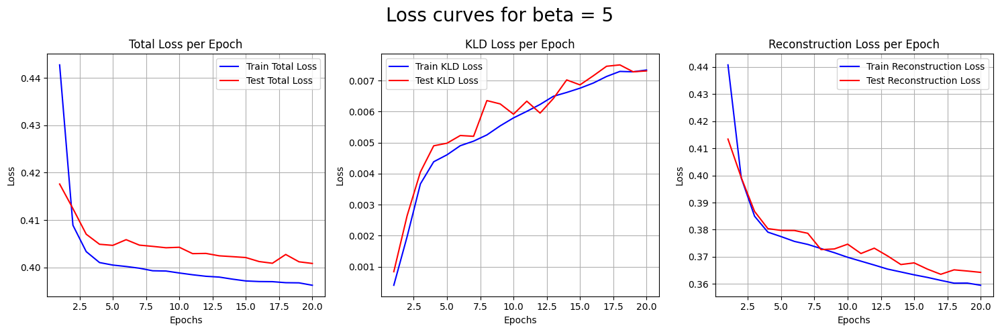

<Figure size 640x480 with 0 Axes>

Loss curves for beta = 10


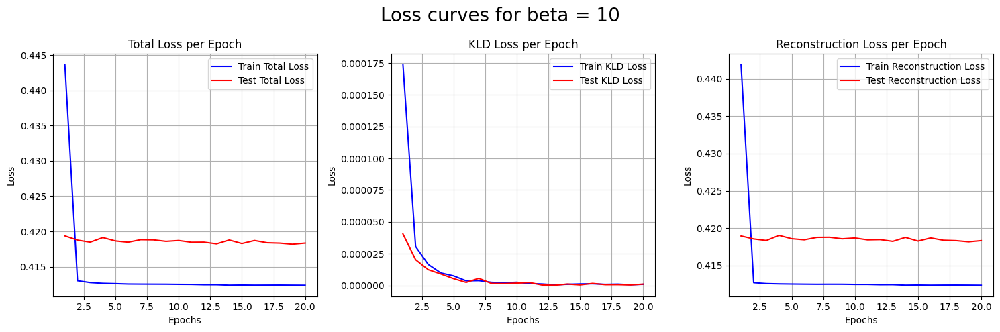

<Figure size 640x480 with 0 Axes>

In [49]:
# *CODE FOR PART 1.2a IN THIS CELL*
# Define plot function for the loss
def plot_losses(train_total_loss_per_epoch, train_reconstruction_loss_per_epoch, train_kld_loss_per_epoch,
               test_total_loss_per_epoch, test_reconstruction_loss_per_epoch, test_kld_loss_per_epoch,
               title, save_flag=False):
    
    epochs = range(1, len(train_total_loss_per_epoch) + 1)

    plt.figure(figsize=(15, 5))
    
    plt.suptitle(title, fontsize=20)

    # Total Loss
    plt.subplot(1, 3, 1)
    plt.plot(epochs, train_total_loss_per_epoch, 'b', label='Train Total Loss')
    plt.plot(epochs, test_total_loss_per_epoch, 'r', label='Test Total Loss')
    plt.title('Total Loss per Epoch')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid()

    # KLD Loss
    plt.subplot(1, 3, 2)
    plt.plot(epochs, train_kld_loss_per_epoch, 'b', label='Train KLD Loss')
    plt.plot(epochs, test_kld_loss_per_epoch, 'r', label='Test KLD Loss')
    plt.title('KLD Loss per Epoch')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid()

    # Reconstruction Loss
    plt.subplot(1, 3, 3)
    plt.plot(epochs, train_reconstruction_loss_per_epoch, 'b', label='Train Reconstruction Loss')
    plt.plot(epochs, test_reconstruction_loss_per_epoch, 'r', label='Test Reconstruction Loss')
    plt.title('Reconstruction Loss per Epoch')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid()

    plt.tight_layout()
    
    plt.show()

    plt.tight_layout()
    if save_flag:
        plt.savefig(f'figures_vae/{title}.png')
    plt.show()



# Plot the loss curves
dataset_list = ['train-test losses/train-test losses for b=0.1.csv', 
                'train-test losses/train-test losses for b=0.5.csv', 
                'train-test losses/train-test losses for b=1.csv', 
                'train-test losses/train-test losses for b=2.csv', 
                'train-test losses/train-test losses for b=5.csv',
                'train-test losses/train-test losses for b=10.csv']

beta_list = [0, 0.5, 1, 2, 5, 10]

beta_index = 0
for dataset in dataset_list:
    data = pd.read_csv(dataset)
    train_total_loss_per_epoch = data['train_total_loss']
    train_reconstruction_loss_per_epoch = data['train_recon_loss']
    train_kld_loss_per_epoch = data['train_kld_loss']
    test_total_loss_per_epoch = data['test_total_loss']
    test_reconstruction_loss_per_epoch = data['test_recon_loss']
    test_kld_loss_per_epoch = data['test_kld_loss']

    print(f"Loss curves for beta = {beta_list[beta_index]}")
    
    plot_losses(train_total_loss_per_epoch, train_reconstruction_loss_per_epoch, train_kld_loss_per_epoch,
                test_total_loss_per_epoch, test_reconstruction_loss_per_epoch, test_kld_loss_per_epoch,
                f"Loss curves for beta = {beta_list[beta_index]}", save_flag=True)
    
    
    beta_index += 1


## Part 1.2b: Samples and Reconstructions (6 Points)
Visualize a subset of the images of the test set and their reconstructions **as well as** a few generated samples. Most of the code for this part is provided. You only need to call the forward pass of the model for the given inputs (might vary depending on your implementation).

For reference, here's [some samples from our VAE](https://imgur.com/NwNMuG3).


Input images
--------------------------------------------------
Reconstructed images
--------------------------------------------------
Generated Images
--------------------------------------------------


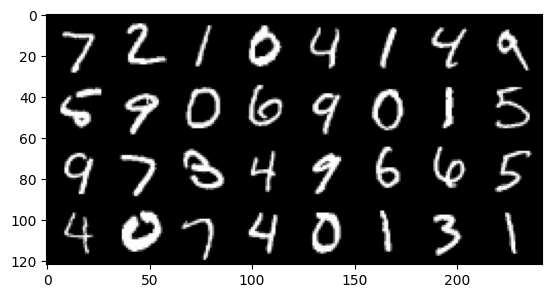

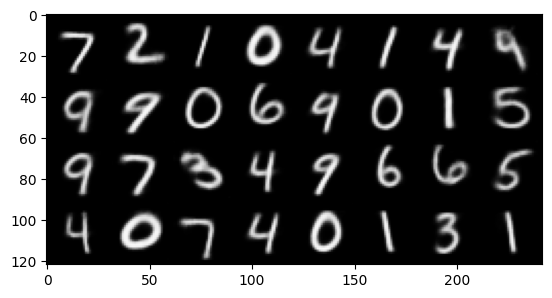

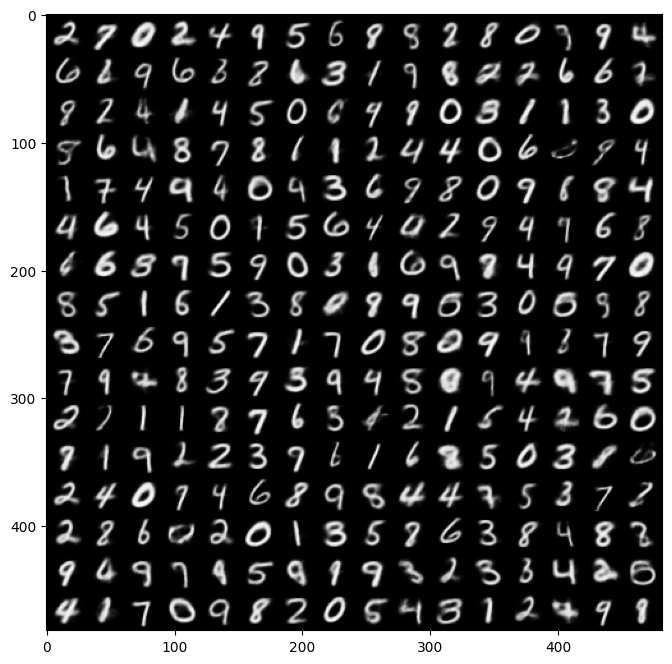

In [13]:
# *CODE FOR PART 1.2b IN THIS CELL*
# load the model of according to the beta
beta = 1

model = torch.load(f"CW_VAE/VAE_model_beta_{beta}.pth")

print('Input images')
print('-'*50)

sample_inputs, _ = next(iter(loader_test))
fixed_input = sample_inputs[0:32, :, :, :]
# visualize the original images of the last batch of the test set
img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure()
show(img)

print('Reconstructed images')
print('-'*50)

with torch.no_grad():
    # visualize the reconstructed images of the last batch of test set
    
    #######################################################################
    #                       ** START OF YOUR CODE **
    #######################################################################
    recon_batch, _, _  = model.forward(fixed_input)
    #######################################################################
    #                       ** END OF YOUR CODE **
    ####################################################################### 
    
    recon_batch = recon_batch.cpu()
    recon_batch = make_grid(denorm(recon_batch), nrow=8, padding=2, normalize=False,
                            value_range=None, scale_each=False, pad_value=0)
    plt.figure()
    show(recon_batch)
    plt.savefig(f'VAE_outputs/Reconstructed (beta={beta})')

print('Generated Images')  
print('-'*50)
model.eval()
n_samples = 256
z = torch.randn(n_samples,latent_dim).to(device)
with torch.no_grad():
    #######################################################################
    #                       ** START OF YOUR CODE **
    #######################################################################
    samples = model.decode(z)
    #######################################################################
    #                       ** END OF YOUR CODE **
    ####################################################################### 
    
    samples = samples.cpu()
    samples = make_grid(denorm(samples), nrow=16, padding=2, normalize=False,
                            value_range=None, scale_each=False, pad_value=0)
    plt.figure(figsize = (8,8))
    show(samples)
    plt.savefig(f'VAE_outputs/Generated (beta={beta})')



### Discussion
Provide a brief analysis of your loss curves and reconstructions: 
* What do you observe in the behaviour of the log-likelihood loss and the KL loss (increasing/decreasing)?
* Can you intuitively explain if this behaviour is desirable? 
* What is posterior collapse and did you observe it during training (i.e. when the KL is too small during the early stages of training)? 
    * If yes, how did you mitigate it? How did this phenomenon reflect on your output samples?
    * If no, why do you think that is?

**YOUR ANSWER**

*Behaviour of Reconstruction and KLD loss*

From the figures above, the reconstruction loss (maximum log likelihood) starts high at approximately but sharply decreases before plateauing at approximately 10 epochs. This rate of decrease indicates that model performance is converging and will likely not benefit from increased epochs. However, this plateau point seems to increase with beta, with $\beta$ =5 curve yet to plateau while training for 20 epochs.  While slightly more volatile, the test loss (red) also closely follows the reconstruction loss, suggesting that the model is generalising well and not overfitting.

Conversely, the KLD loss starts relatively low and sharply increases before quickly plateauing. The point at which the curve plateaus is also variant on $\beta$ , with KLD loss curves being more rounded and less sharp (plateauing more slowly) as $\beta$ is increased. Similar to the reconstruction loss, the test KLD losses also match the train losses closely, again suggesting that the model is performing well and not overfitting. 

While the reconstruction and KLD losses are quite similar, a few other observations can also be made. Firstly, the scale of the KLD loss is smaller than that of the reconstruction, but their respective magnitudes also depend on $\beta$ . As $\beta$  increases, magnitudes of KLD decrease while reconstruction loss magnitudes increase. This implies that KLD losses have a higher contribution at very low levels of $\beta$ . Secondly, the test curves for the KLD loss are less stable than that of the reconstruction loss, being more volatile despite following the training losses closely. While this does not mean overfitting, it shows that the model's latent space regularization is more sensitive to the variations in the data. The KLD loss being more volatile could suggest that the model is trying to balance the latent space distribution with the prior and is affected by the complexity of the test data. 

*Intuitive Explanation of Loss Curves:*

The behaviour of the reconstruction and KLD loss curves can be best explained with the total loss function, where $ \mathcal{L}=\mathbb{E}_{q_\phi(z \mid X)}[\log p_\theta(X \mid z)]-\beta D_{K L}[q_\phi(z \mid X) \| p_\theta(z)]$
is minimised. Here it can be seen that the reconstruction loss $\mathbb{E}_{q_\phi(z \mid X)}[\log p_\theta(X \mid z)]$ should be minimised, represented by the MSE between the expected pixel value and the true pixel value. In this sense, the reconstruction loss is much more intutitive to understand as it follows a the shape of a traditional loss curve, starting high before decreasing and eventually plateauing. 

The KLD loss on the other hand is less intuitive with difficulties stemming from the somewhat unexpected shape of the curve and mathematical derivation of the loss function. From a high level, the KLD loss should be minimised as the latent space is should follow the assumed prior, being the reason for why the KLD loss was introduced in the first place. Without its regularisation effect, input data would be freely mapped onto an unstructured latent space, leading to disorganisation and uninterpretability. Although the KLD loss component (without $\beta$) has been abstractly defined as $D_{K L}[q_\phi(z \mid X) \| p_\theta(z)]$, the KLD loss term can be more usefully derived as $-log\sigma - 1/2 +1/2|\sigma^2 + \mu^2|$ and has been coded as such. While it is tempting to assume that the above KLD loss plot represents $-\beta D_{K L}[q_\phi(z \mid X) \| p_\theta(z)]$ and therefore an increasing $D_{K L}[q_\phi(z \mid X) \| p_\theta(z)]$ is in the loss function's favour, this is not the case. By plotting just the KLD loss $-log\sigma - 1/2 +1/2|\sigma^2 + \mu^2|$ without $-\beta$, it can easily seen that the loss increases in spite of its contribution to the total loss function. This results in a trade-off between the reconstruction loss and the KLD loss with the prior decreasing as the latter increases. However, since the magnitudes of the reconstruction loss are higher, the trade-off is beneficial and model continues to "improve" in this way, prioritising the reconstruction loss. This observed increase coupled with its low magnitude is indicative of what we can expect of VAEs, showing that while we want the KL loss to be small, it is not optimal to be make it 0. At $D_{K L}[q_\phi(z \mid X) \| p_\theta(z)] = 0$, posterior collapse would be observed, where the posterior generated samples would follow the prior distribution too closely, resulting in a repeated, non-distinct image.

*Posterior collapse:*

Posterior collapse is a phenomenon that occurs in Variational Autoencoders (VAEs) when the variational posterior distribution ${q_\phi(z \mid X)}$ collapses to the prior distribution ${q(z)}$, and as a result, the model stops using the latent variables $z$. In other words, the model ignores the latent space in generating the data and relies solely on the decoder's capacity to recreate the data without any meaningful input from the encoder.

Posterior collapse is observed when beta = 5 or 10, weighting the KL divergence too highly and resulting in very small magnitudes, observable in the above plots as well as the generated examples below. In the loss curve plots above, it can be seen that the KLD curve actually flips vertically when beta = 10, showing that the VAE has heavily favoured KLD loss and effectively ignores the reconstruction loss. While both loss curves decrease, they only do so at first before plateauing for the rest of the training, having found a general output image and never improving upon it as it would increase the KLD loss. 

In the examples below, it can be seen that the resultant outputs are a series of unvaried blurred images that resemble a combination of several digits, mostly 0, 1, 8 or 9 when beta = 5 and complete blurr when beta = 10. This is evidence that posterior collapse has occurred and that meaningful input (latent variables) has been ignored with severity increasing with higher values of beta. When beta is decreased to 1, the posterior collapse is not observed, with recreations closely matching actual images, showing that a balance between the KL and reconstruction loss has been achieved.

To mitigate this, beta should be engineered to provide sufficient disentanglement before posterior collapse is reached. Alternatively, a "warm-up" strategy can be implemented called “KL annealing”, where $\beta$ starts at a lower value and gradually increases to the target value over several epochs. Lastly, model architectures could be modified to rely more on the latent space by possibly using a more expressive prior or by modifying the encoder/decoder architectures.

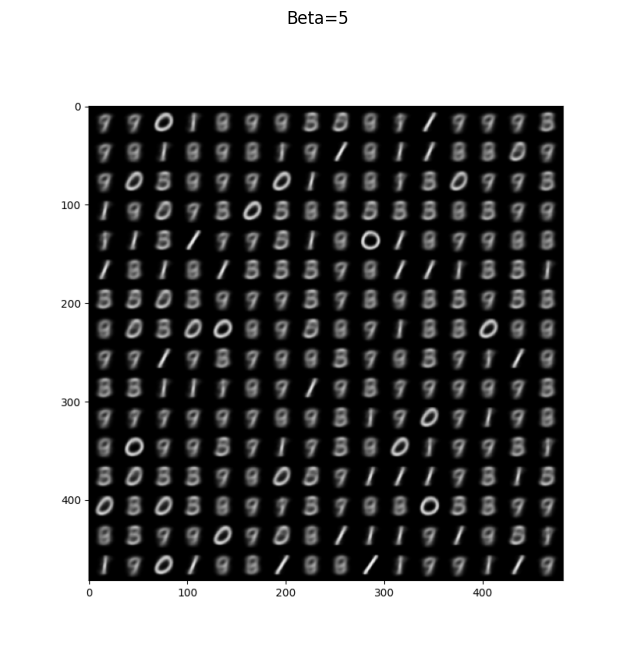

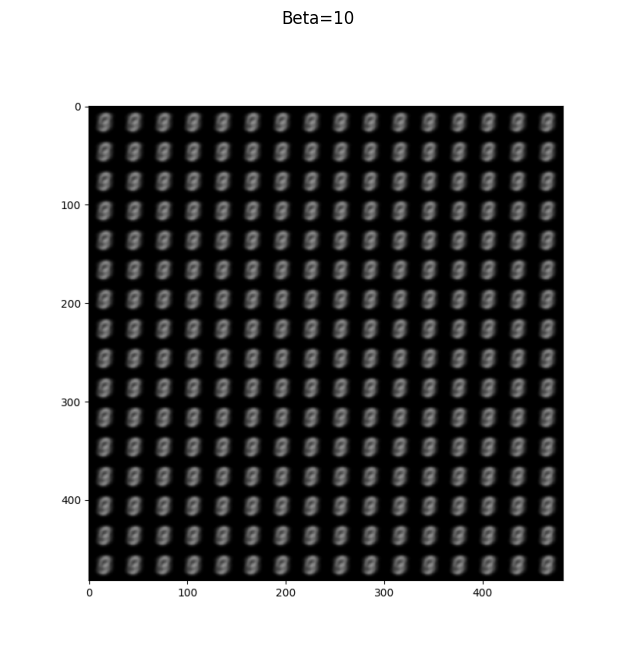

In [14]:
# Additional code to complement discussion above

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

img = mpimg.imread('VAE Generated (beta=5).png')
plt.figure(figsize=(8,8))
plt.imshow(img)
plt.title("Beta=5")
plt.axis('off')
plt.show()

img = mpimg.imread('VAE Generated (beta=10).png')
plt.figure(figsize=(8,8))
plt.imshow(img)
plt.title("Beta=10")
plt.axis('off')
plt.show()

---
<h2> Part 1.3 (11 points) <h2/>

Qualitative analysis of the learned representations

In this question you are asked to qualitatively assess the representations that your model has learned. In particular:

a. Dimensionality Reduction of learned embeddings

b. Interpolating in the latent space

## Part 1.3a: T-SNE on Embeddings (7 Points)
Extract the latent representations of the test set and visualize them using [T-SNE](https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding)  [(see implementation)](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html). You can use a T-SNE implementation from a library such as scikit-learn. 

We've provided a function to visualize a subset of the data, but you are encouraged to also produce a matplotlib plot (please use different colours for each digit class).

In [15]:
# *CODE FOR PART 1.3a IN THIS CELL
from sklearn.manifold import TSNE

# define tsne plot function for exploring beta
def custom_tsne_plot(model_name, test_dataloader, beta, perplexity, num_iterations, save_flag=False):
    # load model
    model = torch.load(f"CW_VAE/VAE_model_beta_{beta}.pt")
    model.eval()
    
    latent_features = np.empty((0,latent_dim))
    labels = np.empty(0)

    with torch.no_grad():
        for data, label in test_dataloader:
            data = data.to(device)
            z, _ = model.encode(data)
            latent_features = np.vstack([latent_features, z.cpu().detach().numpy()])
            labels = np.hstack([labels, label.numpy()])

    tsne = TSNE(n_components=2, perplexity=perplexity, n_iter=num_iterations)
    tsne_results = tsne.fit_transform(latent_features)

    plt.figure(figsize=(16,16), dpi=80)
    unique_labels = np.unique(labels)
    for label in unique_labels:
        indices = np.where(labels == label)
        plt.scatter(tsne_results[indices, 0], tsne_results[indices, 1], label=label)
    plt.legend()
    plt.title(f"Beta = {beta}", fontsize=20)
    plt.show()
    plt.savefig(f"CW_VAE/TSNE_beta_{beta}.png")

# define different functions for exploring perplexity and number of iterations, uses the same model so latent features and labels and can be reused
# define tsne plot function for exploring perplexity
def perplexity_tsne_plot(latent_features, labels, test_dataloader, perplexity, num_iterations, save_flag=False):

    tsne = TSNE(n_components=2, perplexity=perplexity, n_iter=num_iterations)
    tsne_results = tsne.fit_transform(latent_features)

    plt.figure(figsize=(16,16), dpi=80)
    unique_labels = np.unique(labels)
    for label in unique_labels:
        indices = np.where(labels == label)
        plt.scatter(tsne_results[indices, 0], tsne_results[indices, 1], label=label)
    plt.legend()
    plt.title(f"Perplexity = {perplexity}", fontsize=20)
    plt.show()
    plt.savefig(f"CW_VAE/TSNE_perplexity_{perplexity}.png")

# define tsne plot function for exploring number of iterations 
def num_iterations_tsne_plot(latent_features, labels, test_dataloader, perplexity, num_iterations, save_flag=False):
    
    tsne = TSNE(n_components=2, perplexity=perplexity, n_iter=num_iterations)
    tsne_results = tsne.fit_transform(latent_features)

    plt.figure(figsize=(16,16), dpi=80)
    unique_labels = np.unique(labels)
    for label in unique_labels:
        indices = np.where(labels == label)
        plt.scatter(tsne_results[indices, 0], tsne_results[indices, 1], label=label)
    plt.legend()
    plt.title(f"Number of Iterations = {num_iterations}", fontsize=20)
    plt.show()
    plt.savefig(f"CW_VAE/TSNE_num_iterations_{num_iterations}.png")



In [ ]:
# load model
model = torch.load("CW_VAE/VAE_model_beta_1.pt")
model.eval()

# Interactive Visualization - Code Provided
test_dataloader = DataLoader(test_dat, 10000, shuffle=False)

# produce latent features (z_embeddings)
latent_features = np.empty((0,latent_dim))
labels = np.empty(0)

with torch.no_grad():
        for data, label in test_dataloader:
                data = data.to(device)
                z, _ = model.encode(data)
                latent_features = np.vstack([latent_features, z.cpu().detach().numpy()])
                labels = np.hstack([labels, label.numpy()])
                
tsne = TSNE(n_components=2,random_state=1000, init='pca', perplexity=30, n_iter=300)
z_embedded = tsne.fit_transform(latent_features)

""" Inputs to the function are
        z_embedded - Embedded X, Y positions for every point in test_dataloader
        test_dataloader - dataloader with batchsize set to 10000
        num_points - number of points plotted (will slow down with >1k)
"""
plot_tsne(z_embedded, test_dataloader, num_points=1000, darkmode=False)

/vol/bitbucket/kh123/dl-cw2/venv/lib/python3.10/site-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.HConcatChart(...)

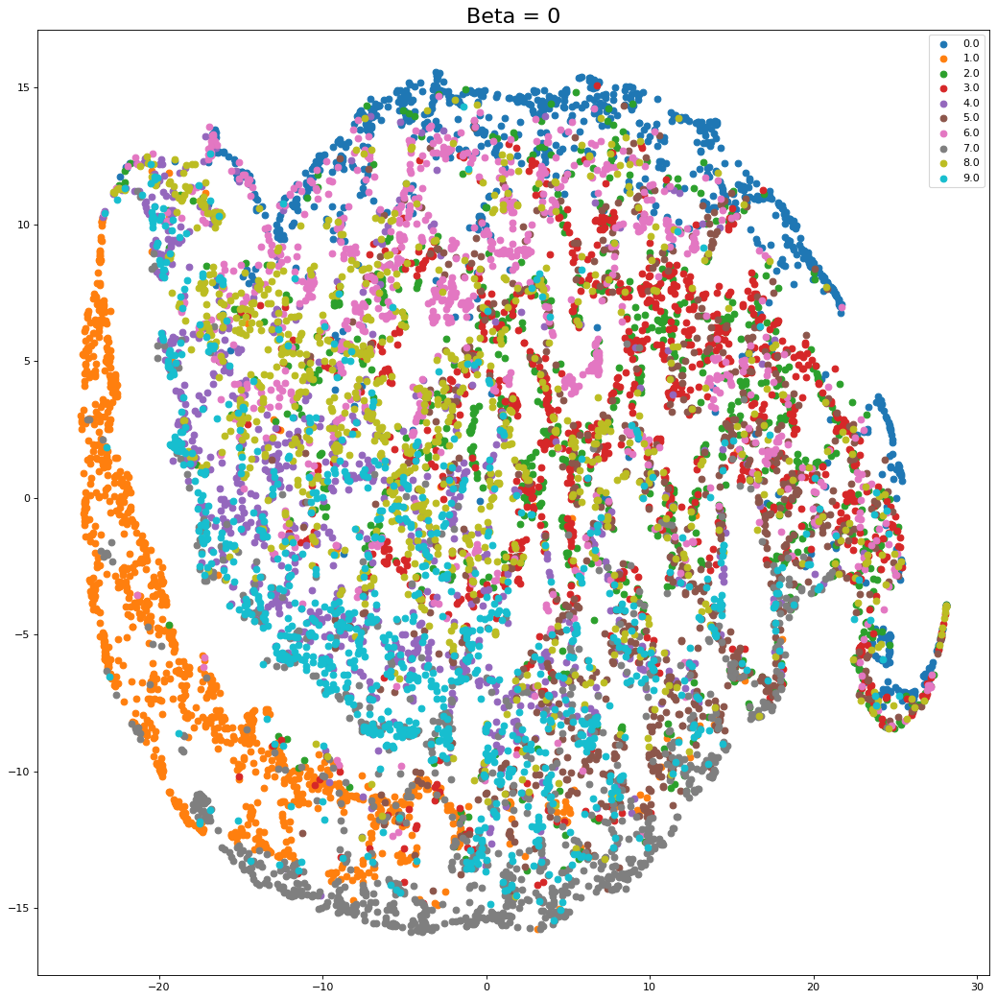

<Figure size 640x480 with 0 Axes>

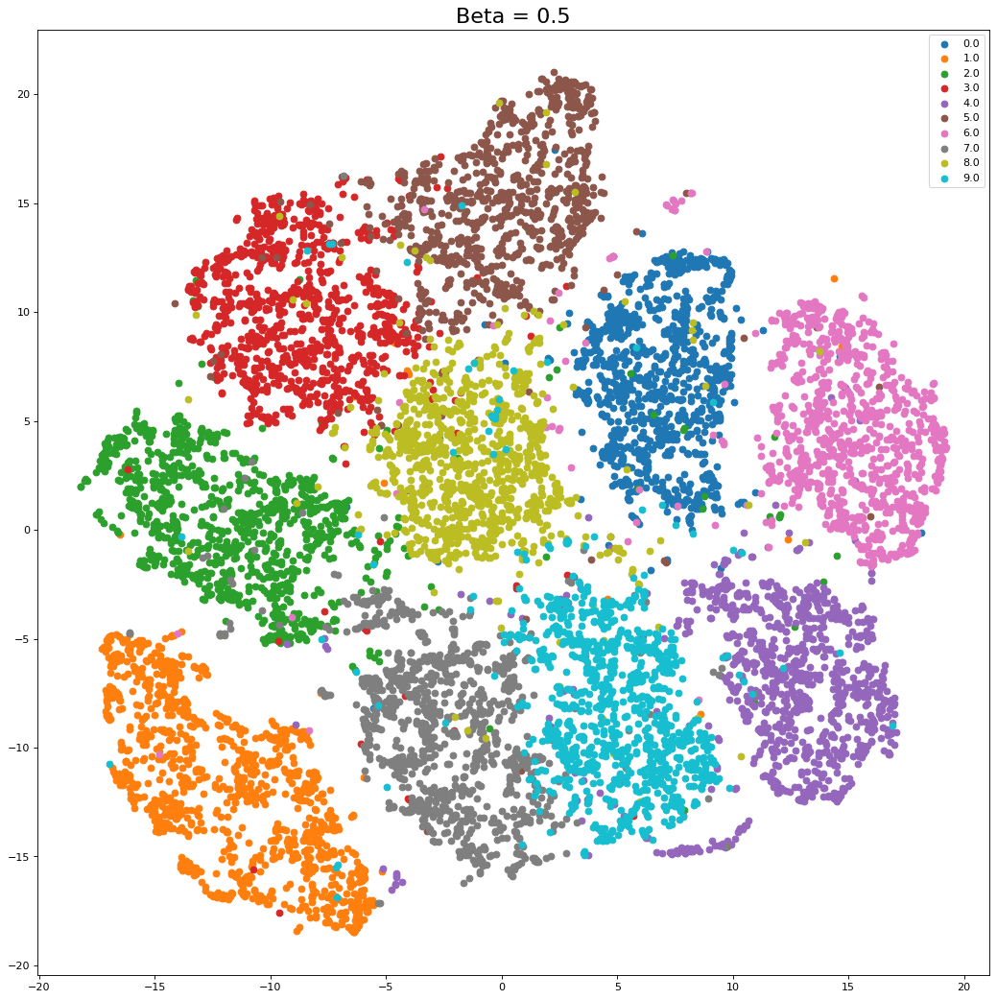

<Figure size 640x480 with 0 Axes>

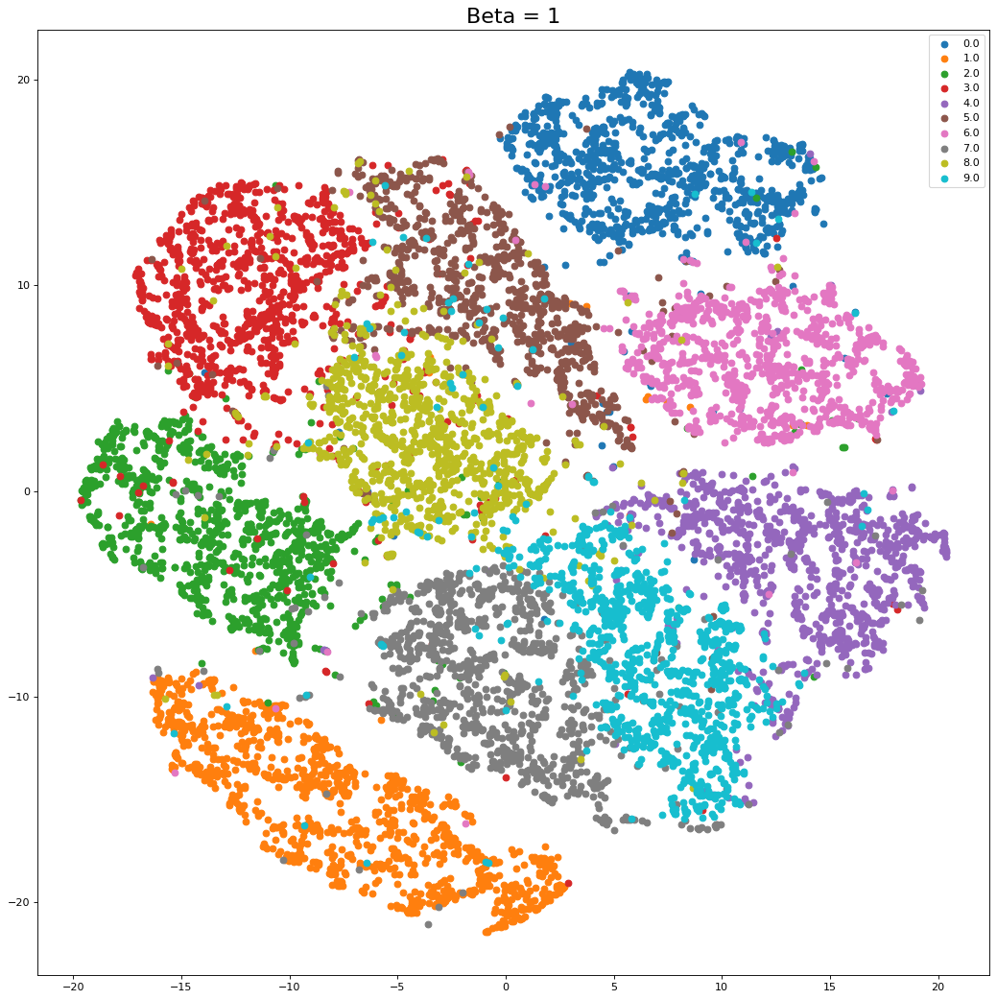

<Figure size 640x480 with 0 Axes>

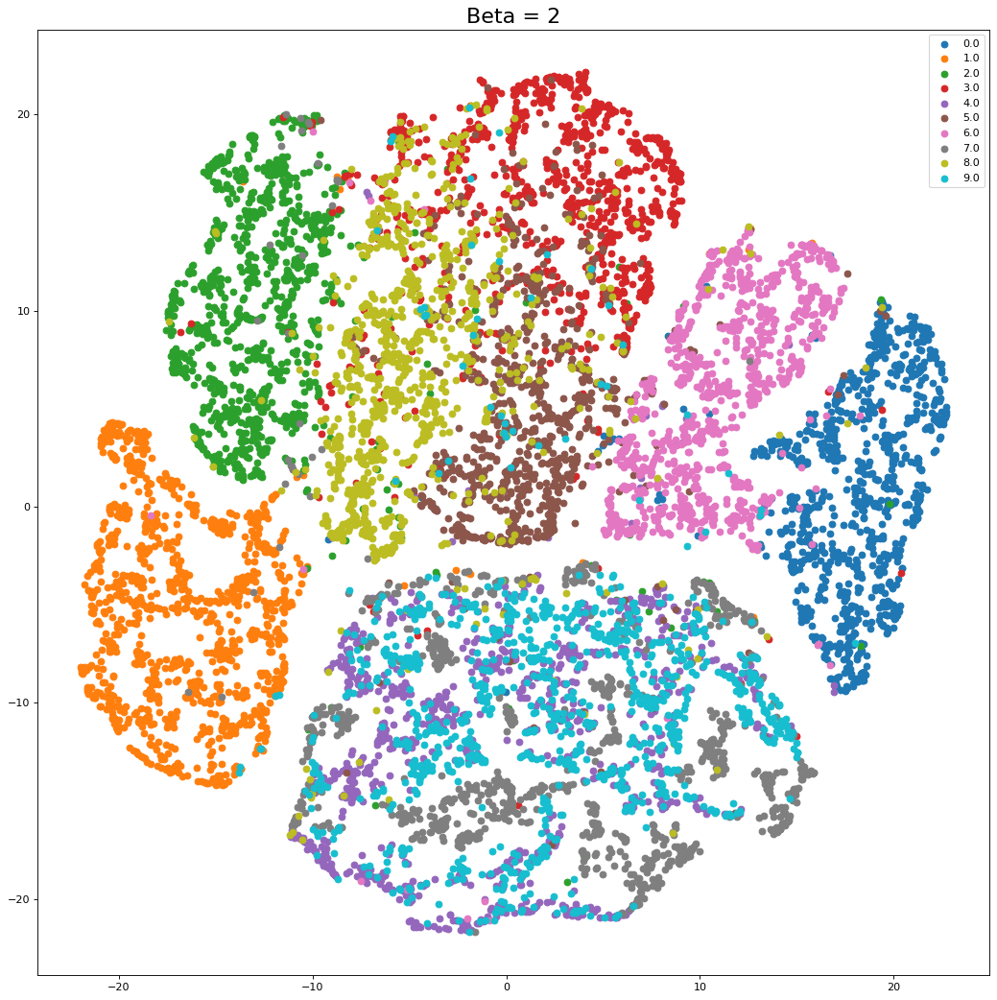

<Figure size 640x480 with 0 Axes>

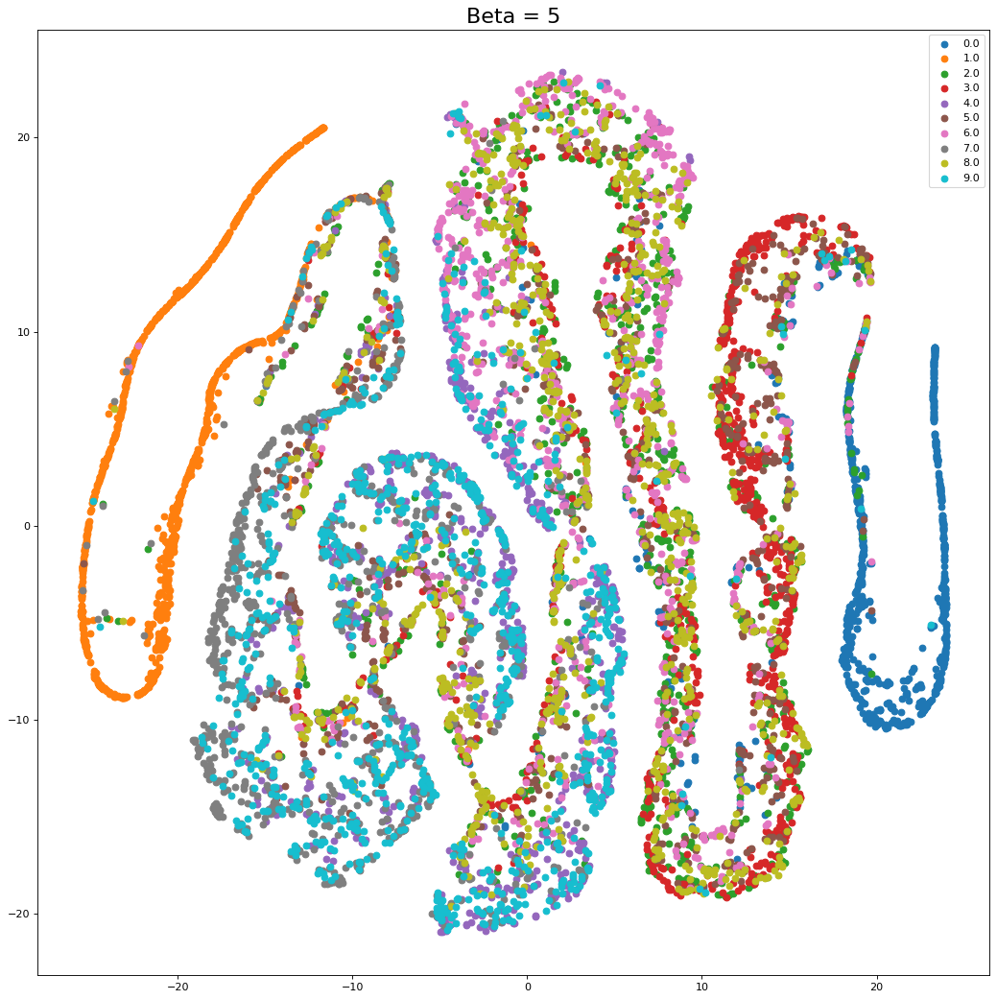

<Figure size 640x480 with 0 Axes>

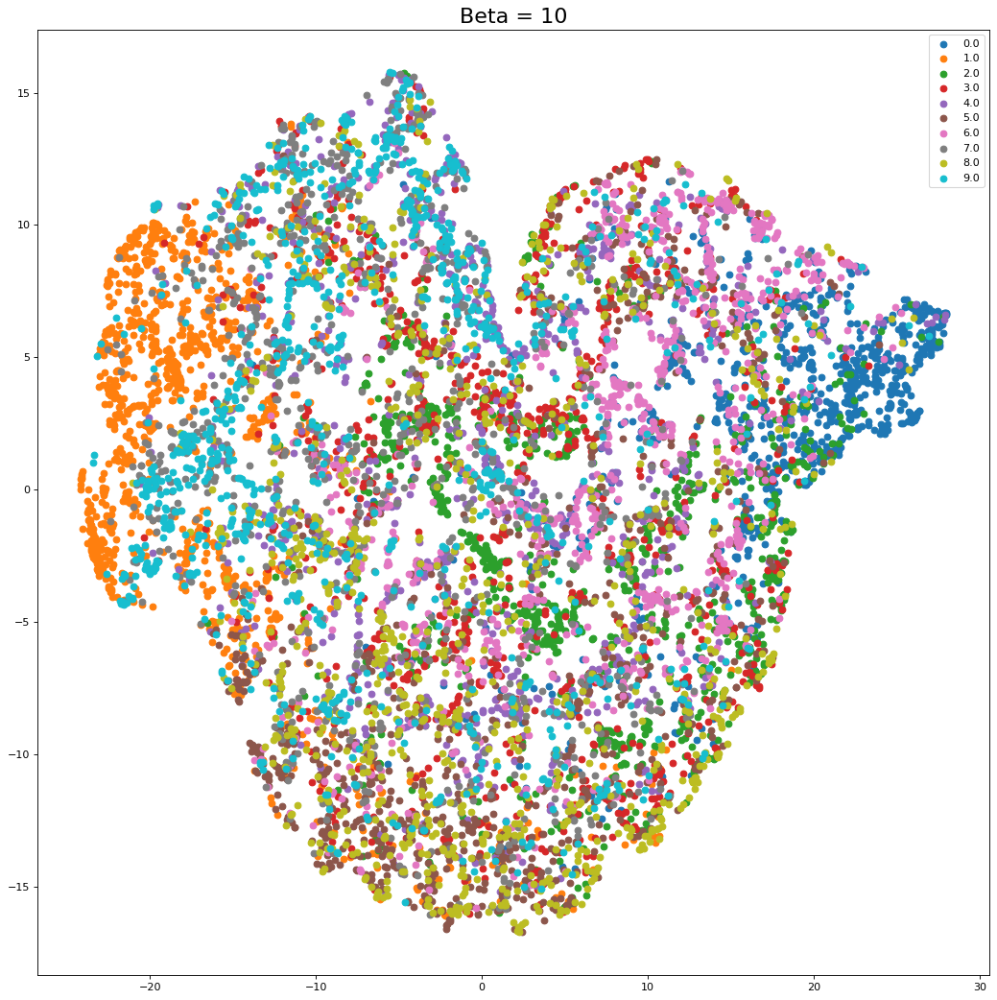

<Figure size 640x480 with 0 Axes>

In [ ]:
# Custom Visualizations
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import numpy as np

# Plot TSNEs for different beta values
beta_list = [0, 0.5, 1, 2, 5, 10]

for beta in beta_list:
    model_name = f"CW_VAE/VAE_model_beta_{beta}.pt"
    custom_tsne_plot(model_name, test_dataloader, beta, 30, 350, save_flag=True)

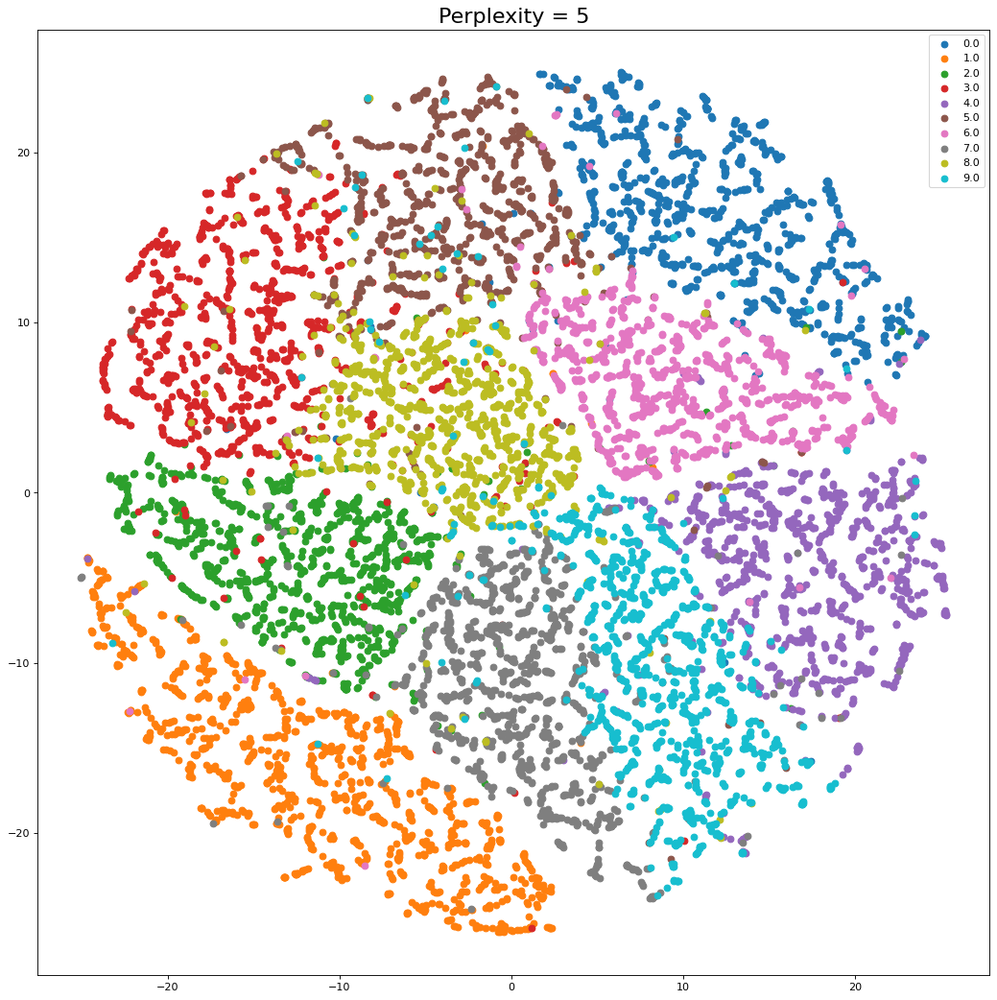

<Figure size 640x480 with 0 Axes>

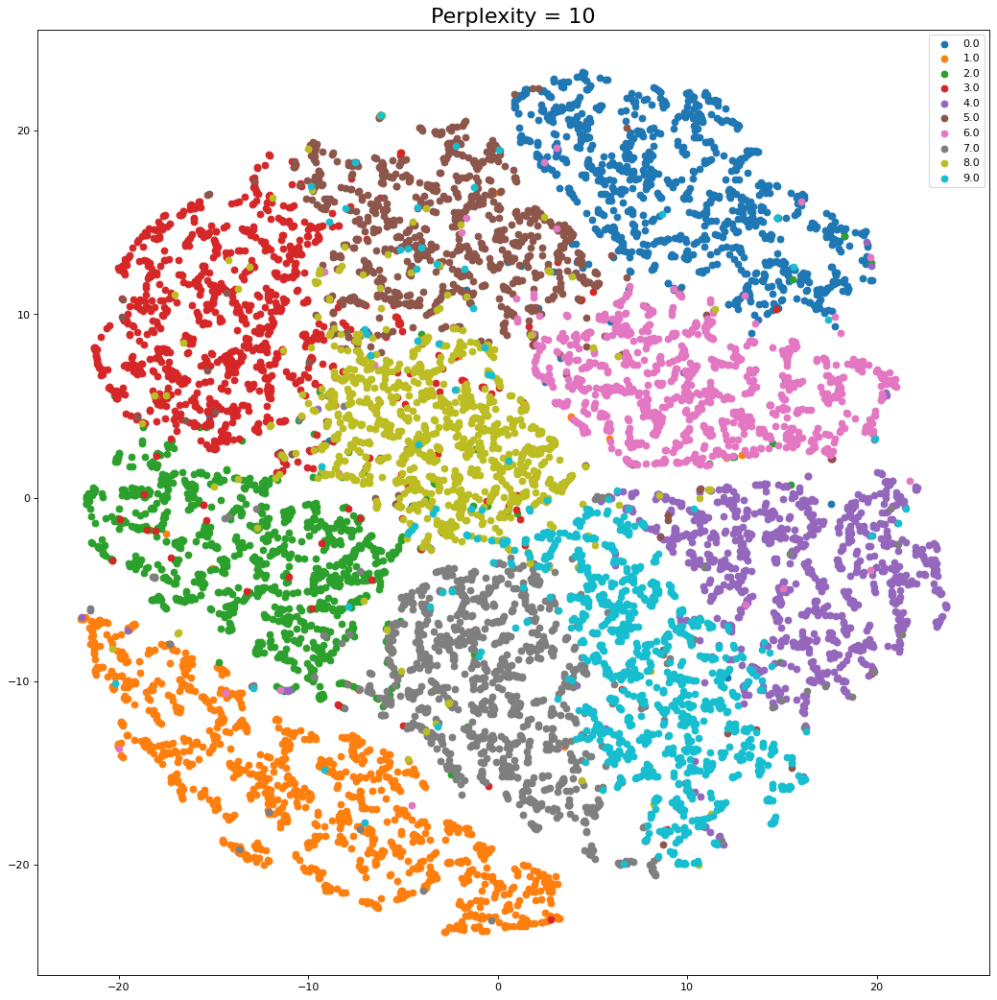

<Figure size 640x480 with 0 Axes>

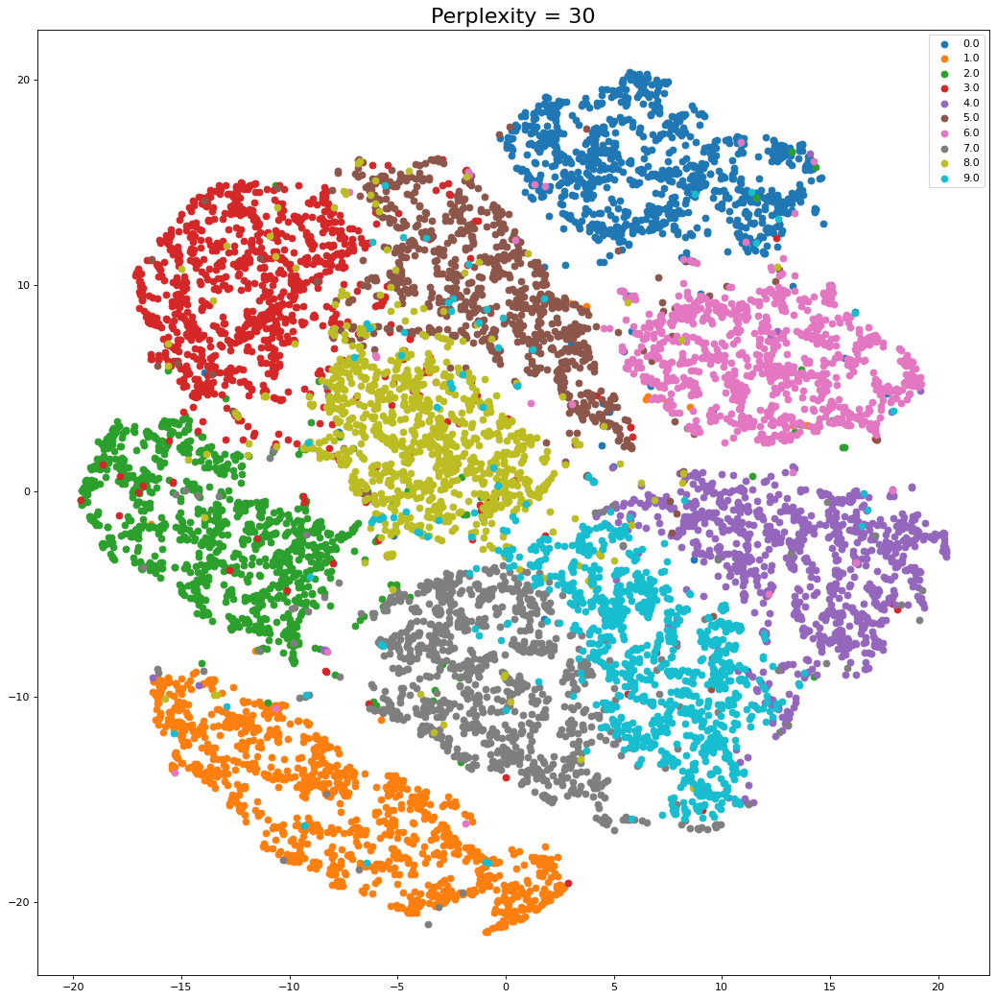

<Figure size 640x480 with 0 Axes>

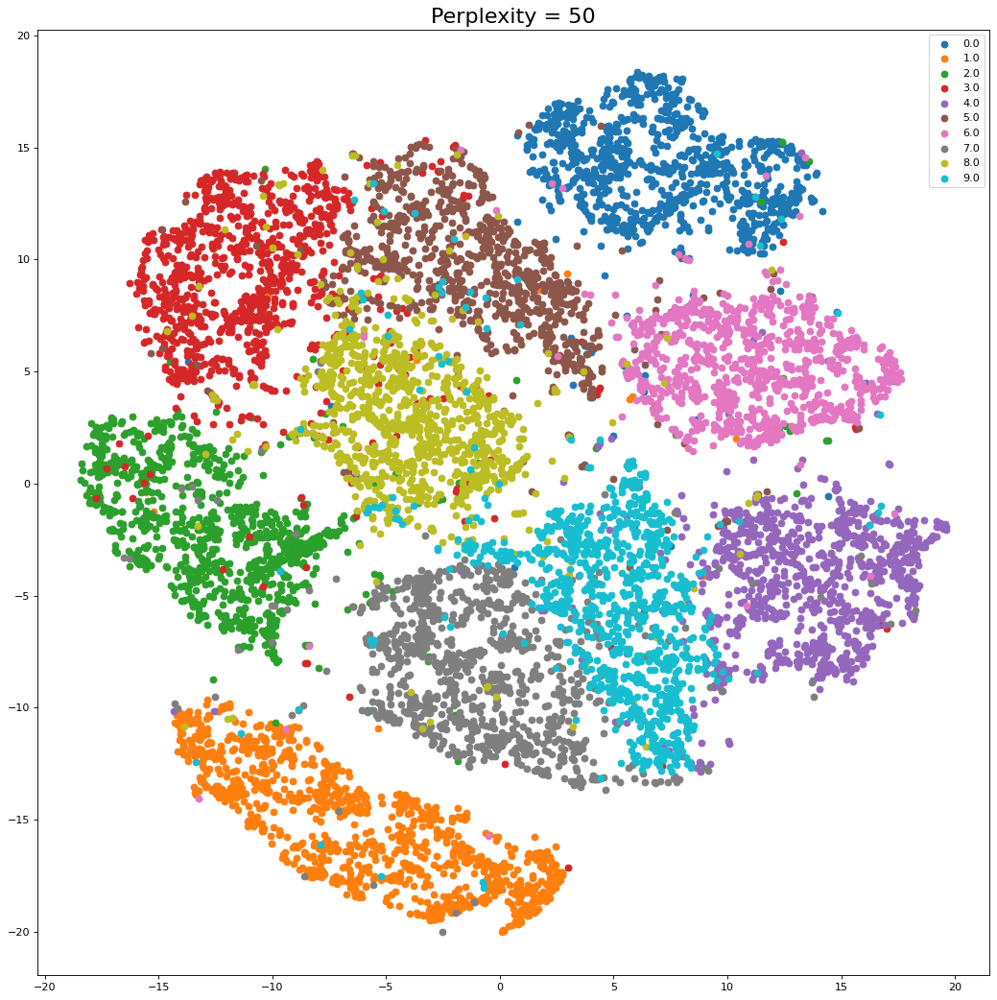

<Figure size 640x480 with 0 Axes>

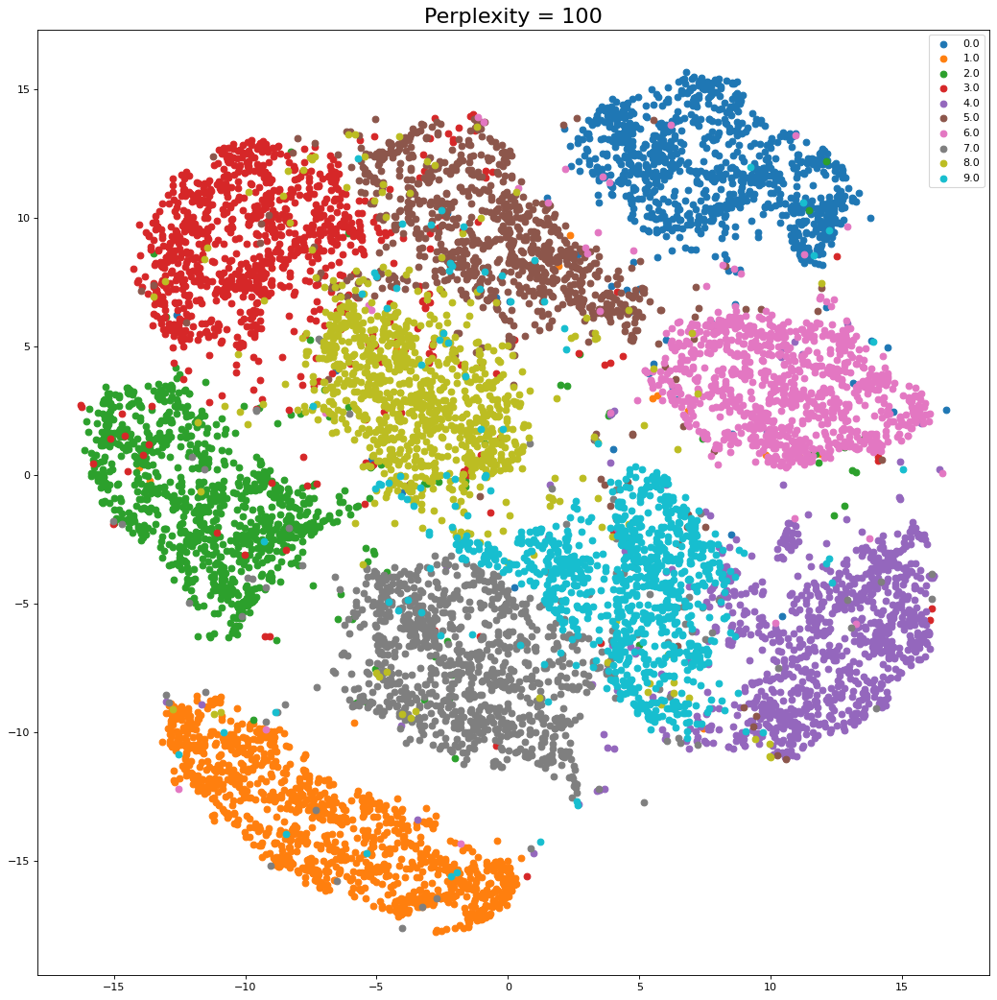

<Figure size 640x480 with 0 Axes>

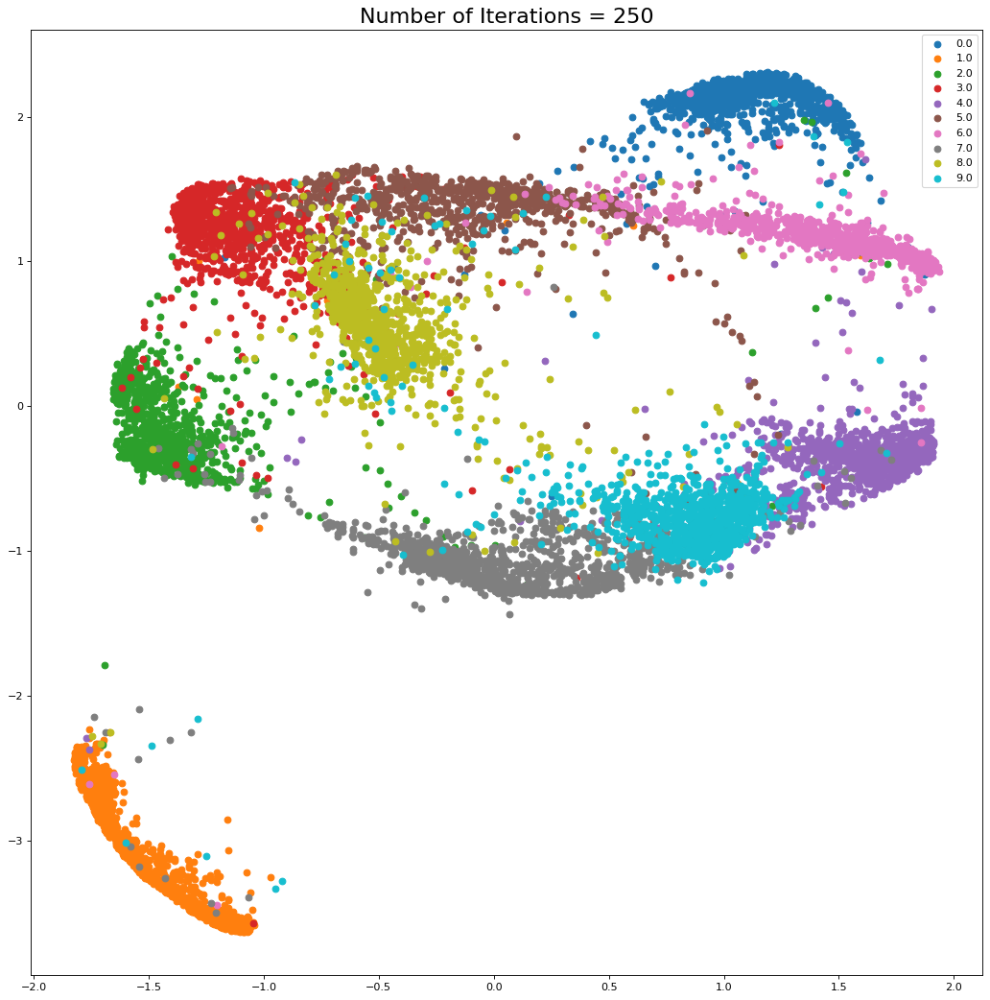

<Figure size 640x480 with 0 Axes>

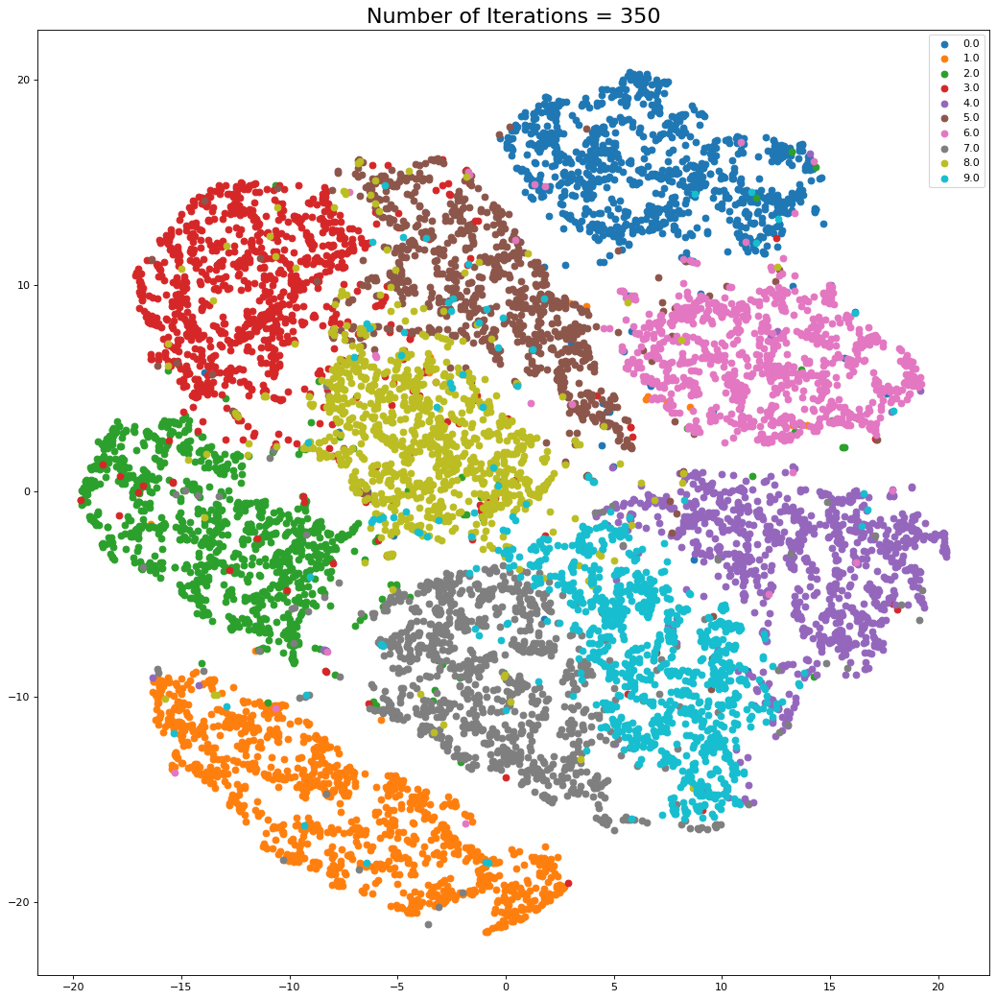

<Figure size 640x480 with 0 Axes>

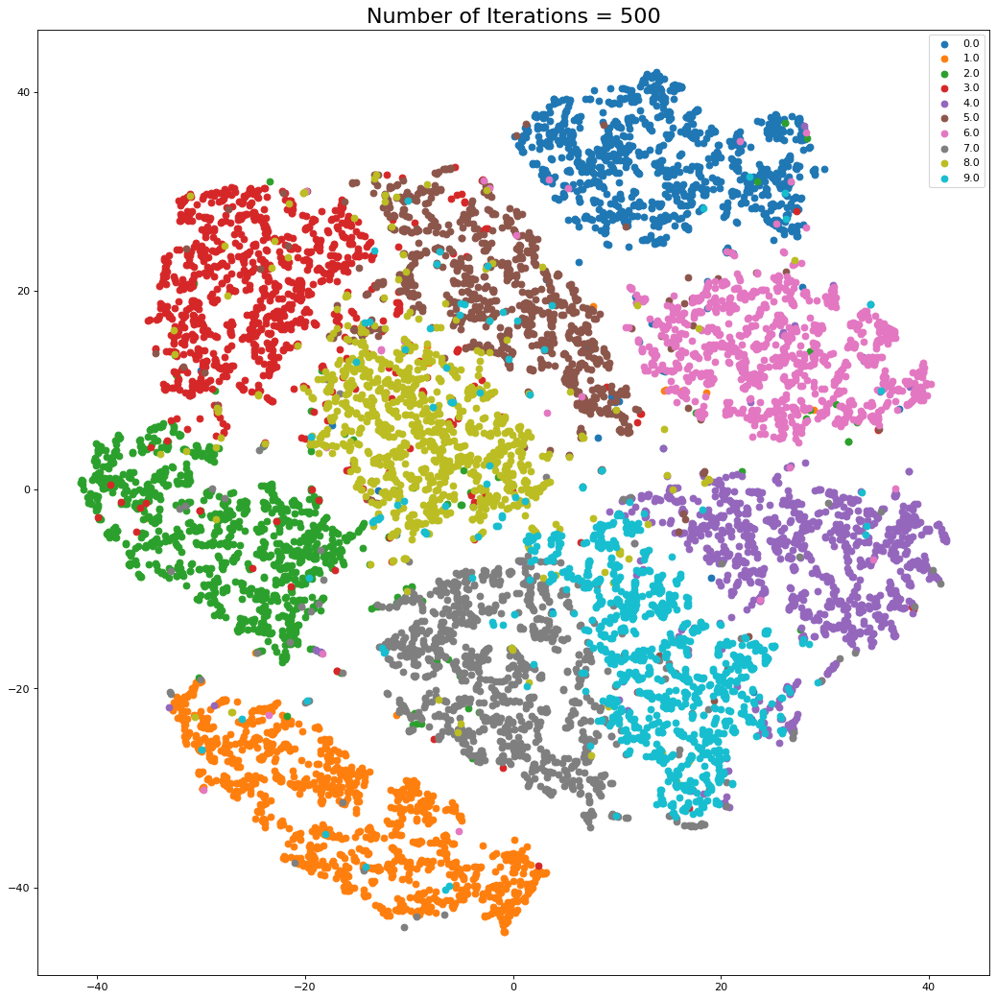

<Figure size 640x480 with 0 Axes>

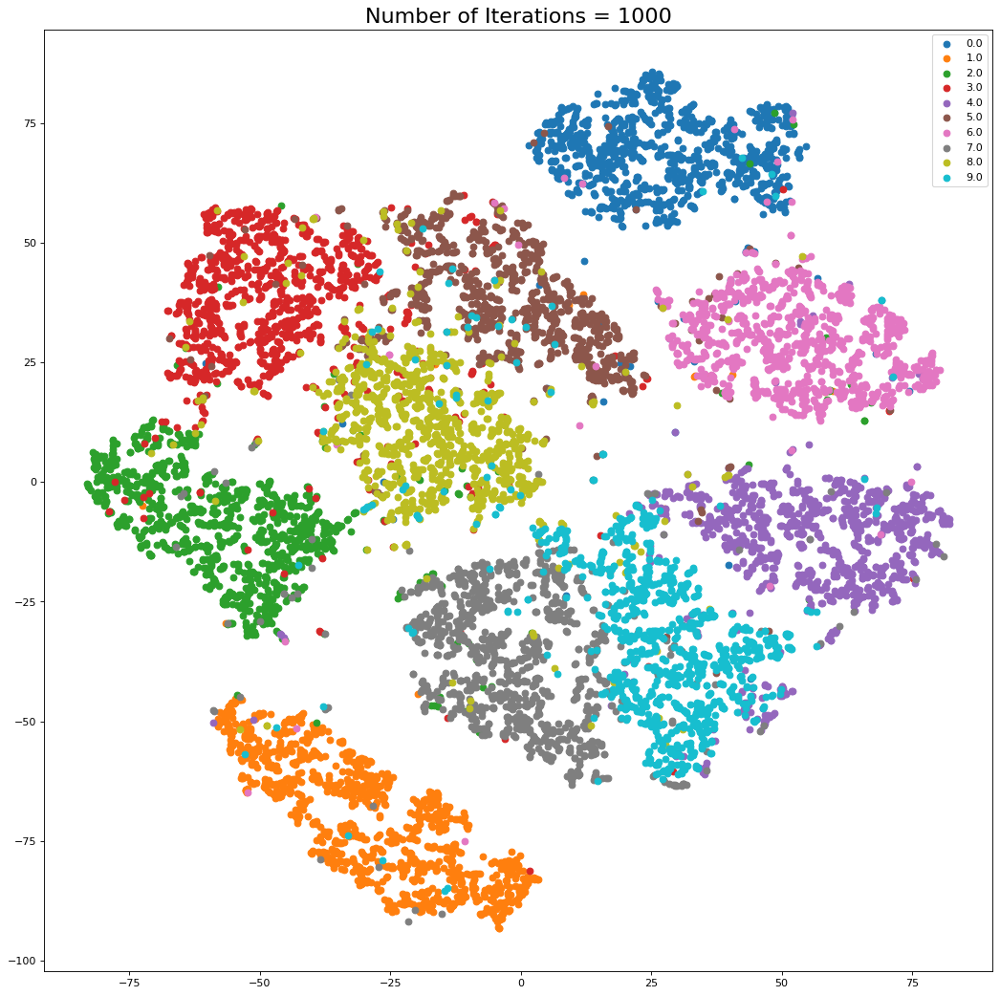

<Figure size 640x480 with 0 Axes>

In [ ]:
# Plot for different Perplexities and Number of Iterations
model = torch.load(f"CW_VAE/VAE_model_beta_1.pt") # keep fixed
model.eval()

# produce latent features for all tsne plots to use (will later be transformed by their respective TSNE processes)
latent_features = np.empty((0,latent_dim))
labels = np.empty(0)

with torch.no_grad():
    for data, label in test_dataloader:
        data = data.to(device)
        z, _ = model.encode(data)
        latent_features = np.vstack([latent_features, z.cpu().detach().numpy()])
        labels = np.hstack([labels, label.numpy()])
        
        
perplexity_list = [5, 10, 30, 50, 100]
iterations_list = [250, 350, 500, 1000]

# plot for different perplexities
for perplexity in perplexity_list:
    model_name = f"CW_VAE/VAE_model_beta_1.pt"
    perplexity_tsne_plot(latent_features, labels, test_dataloader, perplexity, 350, save_flag=True)

# plot for differentresu
for num_iterations in iterations_list:
    model_name = f"CW_VAE/VAE_model_beta_1.pt"
    num_iterations_tsne_plot(latent_features, labels, test_dataloader, 30, num_iterations, save_flag=True)


### Discussion
What do you observe? Discuss the structure of the visualized representations. 
* What do you observe? What role do the KL loss term and $\beta$ have, if any, in what you observe (multiple matplotlib plots may be desirable here)?
    * Consider Outliers
    * Counsider Boundaries
    * Consider Clusters
* Is T-SNE reliable? What happens if you change the parameters (don't worry about being particularly thorough). [This link](https://distill.pub/2016/misread-tsne/) may be helpful.

Note - If you created multiple plots and want to include them in your discussion, the best option is to upload them to (e.g.) google drive and then embed them via a **public** share link. If you reference local files, please include these in your submission zip, and use relative pathing if you are embedding them (with the notebook in the base directory)

**YOUR ANSWER**

**Observations (outliers, boundaries, clusters)**

In the context of VAEs, t-distributed Stochastic Neighbor Embedding (t-SNE) serves as a powerful tool to visualize the organization of data in the VAE's latent space. The following observations, based on t-SNE plots, shed light on how different numbers are distributed and clustered in a 64-dimensional latent space.

- *Inherent Clustering:* Across nearly all plots, there is a natural clustering of different numbers in the latent space. Although varying levels of distinction is found, this natural clustering is even apparent in the $\beta=0$ plot. This phenomenon aligns well with our expectations, as it demonstrates the VAE’s ability to learn and encode distinctive features of various digits into discernible, separate groups in the latent space. This clustering is less apparent as beta at very low and very high values, as discussed later on. 

- *Proximity of Similar Numbers:* Another notable aspect is the proximity of number clusters, corresponding to similarity. For instance, numbers that share visual similarities, such as '6' and '9', or '1' and '7', tend to be located closer in the latent space. This proximity suggests that the VAE not only captures the unique characteristics of each digit but also recognizes and encodes the underlying similarities between them.

- *Outlier Distribution:* The presence of outliers is an important aspect of the latent space topology. The distribution and frequency of these outliers vary with different beta values. Typically, outliers do not deviate excessively from their nearest clusters, suggesting a level of consistency in how the VAE processes atypical or less common representations of numbers.

- *Beta and Outliers:* The impact of beta on outliers is particularly interesting. At moderate beta values, strong and distinct clusters are produced, leading to a higher number of easily recognisable outliers. At very low or highe values of beta, clusters are less distinct with more overlap, making it difficult to identify between regular and irregular data points. This way, it can be concluded that extreme values of beta make the the difference between in and out-of-cluster samples becomes less clear. 


**Role of the KL Loss Term and Beta**

The hyperparameter $\beta$ in VAEs plays a crucial role in determining the structure of these clusters. As $\beta$ varies, it influences the trade-off between the reconstruction ability and the adherence to the prior distribution, which in turn affects the spacing between clusters. In theory, high values of $\beta$ encourage the model to adhere very closely to the prior distribution, potentially leading to mixed clusters or unclear cluster boundaries. Conversely, low values of $\beta$ result in a lack of restriction in the latent space, potentially becoming sparse or disorganised. 

In the generated T-SNE plots, these expectations are also observed. When considering extreme values of beta (very low and very high), plots show very mixed clusters, clearly meeting the expectations according to very high $\beta$ theory. While the same occurs for $\beta=0$ (with the clusters of all numbers merged into one space), this is due to variables being freely mapped to the latent space, not an over-conformity to prior distribution. This is also in line with expectations of low $\beta$ theory. Conversely, with moderate values of $\beta$, distinct clusters are formed, strongly structured in the latent space due to a balanced regularisation effect. To better describe beta’s effect on the latent space (and consequently generated images), let’s analyse each TSNE plot. 

-	At $\beta=0$, the latent space is not regularised at all, resulting in a "sparse" latent space without any enforced structure. This lack of regularisation has resulted in numbers being mapped into the latent space freely, being distributed greatly across the space. However, there are still some observable clusters in plot, likely due to the inherent features that numbers of the same type have. The most notable clusters are 0 (blue) and 1 (orange), perhaps showing that they are naturally the most distinct.
-	At increasing but low levels of beta, the latent space is only slightly regularised, but quickly becomes more structured. As a large improvement from the $\beta=0$ figure, very distinct clusters have formed with only slightly more overlap with neighbouring clusters. This shows that the regularised space starting to assume the distribution of the assumed prior (a Gaussian).  
-	At moderate levels of $\beta$ $(\beta=2)$, clusters are still observable but with significantly more overlap with neighbouring clusters, showing that visually similar numbers are mapped closely together in the latent space, such as 7 (grey) and 9 (cyan). At this stage, some of these overlapping clusters have formed distinct supergroups while the distinct supergroups themselves have significant space between their boundaries. At this stage, $\beta$ has added moderate regularisation to the latent space, providing structure and enforcing a moderate fit to the assumed prior.
-	At high levels of beta $(\beta=10)$, there are extremely high levels of regularisation, reducing nearly all points to 1 large supercluster. While there are slightly higher concentrations of same-number instances in some areas (like in $\beta=0$), the supercluster is generally a highly distributed, homogenous mixture of all number samples. This shows that $\beta$ has added too much regularisation to the latent space and has led to posterior collapse, where the posterior (generated) samples have completely assumed the shape of the prior. Observing this T-SNE plot, it is clear that sampling from this distribution would result in low-variance samples regardless of the actual number that attempting to be generated, as evidenced by the repeated generated images pictured below. 

Considering these factors, $\beta=1$ was chosen as the best balance between regularising the latent space and leaving enough variance to generate distinct images and avoid posterior collapse. 

**Reliability of T-SNE**

T-Distributed Stochastic Neighbour Embedding (t-SNE) excels at revealing the inherent structure of data by projecting it onto a lower-dimensional space, typically two or three dimensions. This technique allows for the analysis of the feature representations in a latent hyperspace, such as those generated by Variational Autoencoders (VAEs). While the reliability of t-SNE visualizations hinges on its hyperparameters, the T-SNE plots shown are reliable, having explored the effects of hyperparameters such as perplexity and the number of iterations.

- Perplexity is defined as a measure of the effective number of neighbours with a lower perplexity focusing on the local structure, potentially missing global patterns, and a higher perplexity blending distinct clusters, possibly obscuring finer details. For our TSNE plots, it can be seen that as perplexity increases, the clusters become more segregated with larger spaces in between clusters. While the overall shape of the clusters changes, they stay in the same relative locations and can be distinctly identified. Even with a low perplexity that results in little space between clusters, cluster boundaries are very distinct. Therefore these plots are reliable, having the same relevant information for visualisation regardless of the perplexity. 
- Similarly, the number of iterations determines the extent to which the t-SNE algorithm converges to a stable solution. Insufficient iterations may lead to under-optimized, misleading representations, whereas too many iterations might not yield significant further improvements, considering computational efficiency. These theoretical trade-offs are also observed here. At a low number of iterations, the clusters are apparent but not well formed, as seen in the TSNE plot where the number of iterations is 250 (minimum). Here, there is varied levels of cluster shape and segregation between clusters, indicative of a plot that yet to converge to a stable solution. In plots where the number of iterations is high (i.e. 1000), neglible changes show that there is little improvement to be gained after convergence as been reached at approximately 350. As such, the TSNE plots are reliable as they show that sufficient performance can be achieved with just 350 iterations, being just as good as 1000 iterations. As such 350 iterations was also the value chosen as a hyperparameter when exploring the affect beta in the first series of TSNE plots above.


## Part 1.3b: Interpolating in $z$ (4 Points)
Perform a linear interpolation in the latent space of the autoencoder by choosing any two digits from the test set. What do you observe regarding the transition from on digit to the other?

_hint: Locate the positions in latent space of 2 data points (maybe a one and an eight). Then sample multiple latent space vectors along the line which joins the 2 points and pass them through the decoder._


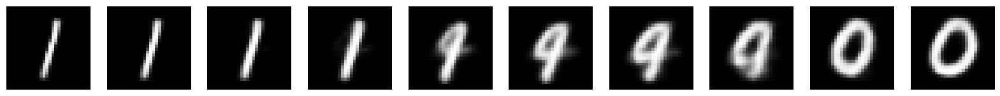

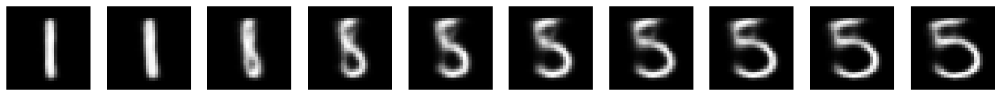

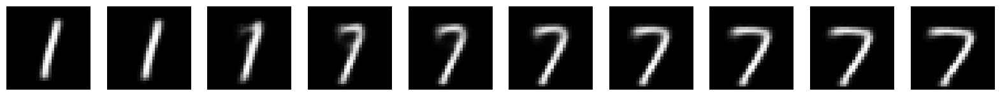

In [ ]:
# CODE FOR PART 1.3b IN THIS CELL

# Define interpolation function
def interpolate_images(img1, img2, model, steps=10):
    model = torch.load(f"CW_VAE/VAE_model_beta_1.pt")
    model.eval()
    
    # Ensure the images are on the same device as the model
    img1, img2 = img1.to(device), img2.to(device)
    
    # Encode images to latent space
    mu1, logvar1 = model.encode(img1)
    mu2, logvar2 = model.encode(img2)
    
    # Reparameterize
    z1 = model.reparametrize(mu1, logvar1)
    z2 = model.reparametrize(mu2, logvar2)
    
    # Interpolate in latent space
    interpolates = []
    for i in np.linspace(0, 1, steps):
        z = (1 - i) * z1 + i * z2
        interpolates.append(z)
    
    # Decode latent representations to images
    interpolated_images = [model.decode(z).cpu().detach() for z in interpolates]
    
    # Plot the results
    fig, axes = plt.subplots(1, steps, figsize=(20, 2))
    for i, ax in enumerate(axes):
        ax.imshow(interpolated_images[i].squeeze(), cmap='gray')
        ax.axis('off')
    plt.show()


number_dictionary = {
    0: [3,10],
    1: [2,5],
    2: [1],
    3: [],
    4: [6,4],
    5: [],
    6: [11],
    7: [0],
    8: [],
    9: [7,8,9],
}

# First interpolation
test_images = next(iter(loader_test))[0]  # Get a batch of images
img1 = test_images[2].unsqueeze(0)  # image of the number 1
img2 = test_images[3].unsqueeze(0)  # image of the number 0
interpolate_images(img1, img2, model, steps=10)

# Second Interpolation
img3 = test_images[14].unsqueeze(0)  # image of the number 1
img4 = test_images[15].unsqueeze(0)  # image of the number 5
interpolate_images(img3, img4, model, steps=10)

# Third Interpolation
img5 = test_images[2].unsqueeze(0)  # image of the number 1
img6 = test_images[0].unsqueeze(0)  # image of the number 5
interpolate_images(img5, img6, model, steps=10)



### Discussion
What did you observe in the interpolation? Is this what you expected?
* Can you relate the interpolation to your T-SNE visualization

**YOUR ANSWER**

To observe the linear interpolation between two samples, 12 images from the interpolation were generated. Moving from left to right in the figure below, we can see that images have been generated from the interpolation between a handwritten 1 and 0. These two digits were chosen for their large separation in the latent space (as seen in the TNSE plots), giving the most opportunity to analyse our interpolations within the latent space work.

In the figure below, it can be seen that the “1” slowly morphs into the “0”, becoming more blurred as the transition progresses before becoming more defined as the final “0” is produced. This blurring is expected as points along the linear interpolation can be viewed as a “middle-ground” between two distinct numbers, with the generator trying to combine these “in-between” features in the latent space in the output image. 

Interestingly, due to the clear distinction of the digits 1 and 0, another digit is also produced briefly as 1 transitions to 0: the digit 4. While not originally expected, it can be qualitatively observed that the produced “4” image does combine distinct features from 1 and 0, being both sharp and angled like the digit “1” while having a closed loop like the digit “0”. This can be further explained quantitatively through the TSNE plot as the clusters for 0 and 1 appear furthest at opposite ends of the latent space. The cluster for “4” however (purple), appears in the middle of the latent space, alluding to the possibility that the linear interpolated points ended up being mapped close to the “4” cluster with “4” acting as a natural middle ground between 1 and 0. This phenomenon of a third number appearing during the transition from one number to the next can be seen in other examples, such as in the transition between “1” and “5” below. In this example, “8” briefly appears, with the “8” cluster (yellow) also being in between the “1” and “5” (brown) clusters.

In conclusion, linearly interpolating across the latent space will result in morphed images that transition from one number to another, but also may result in the emergence of other numbers that naturally happen to be in between the respective clusters in the latent space. The emergence of numbers are also more likely when the space between the clusters in the latent space is large, reflective of the two digits having very distinct features. The type of the emerged third digit is also highly variant, with the interpolation between 1 and 0 sometimes producing “8” or “9” (cyan), both of which reside in between the “1” and 0” clusters. In contrast, digits that are naturally similar and whose clusters lie close together in the latent space would see smoother transitions, not observing the emergence of a third digit. These transitions are also more gradual, as step sizes during interpolation would be smaller, as seen in the example of “1” transitioning to “7”.


# Part 2 - Deep Convolutional GAN

In this task, your main objective is to train a DCGAN (https://arxiv.org/abs/1511.06434) on the CIFAR-10 dataset. You should experiment with different architectures and tricks for stability in training (such as using different activation functions, batch normalization, different values for the hyper-parameters, etc.). In the end, you should provide us with: 

- your best trained model (which we will be able to load and run), 
- some generations for the fixed latent vectors $\mathbf{z}\sim \mathcal{N}\left(\mathbf{0}, \mathbf{I}\right)$ we have provided you with (train for a number of epochs and make sure there is no mode collapse), 
- plots with the losses for the discriminator $D$ and the generator $G$ as the training progresses and explain whether your produced plots are theoretically sensible and why this is (or not) the case. 
- a discussion on whether you noticed any mode collapse, where this behaviour may be attributed to, and explanations of what you did in order to cope with mode collapse. 

## Part 2.1 (30 points)
**Your Task**: 

a. Implement the DCGAN architecture. 

b. Define a loss and implement the Training Loop

c. Visualize images sampled from your best model's generator ("Extension" Assessed on quality)

d. Discuss the experimentations which led to your final architecture. You can plot losses or generated results by other architectures that you tested to back your arguments (but this is not necessary to get full marks).


_Clarification: You should not be worrying too much about getting an "optimal" performance on your trained GAN. We want you to demonstrate to us that you experimented with different types of DCGAN variations, report what difficulties transpired throughout the training process, etc. In other words, if we see that you provided us with a running implementation, that you detail different experimentations that you did before providing us with your best one, and that you have grapsed the concepts, you can still get good marks. The attached model does not have to be perfect, and the extension marks for performance are only worth 10 points._

In [23]:
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torch.utils.data import sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
from torch.optim.lr_scheduler import StepLR, MultiStepLR
import torch.nn.functional as F
import matplotlib.pyplot as plt

mean = torch.Tensor([0.4914, 0.4822, 0.4465])
std = torch.Tensor([0.5, 0.5, 0.5])
unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())

def denorm(x, channels=None, w=None ,h=None, resize = False):
    
    x = unnormalize(x)
    if resize:
        if channels is None or w is None or h is None:
            print('Number of channels, width and height must be provided for resize.')
        x = x.view(x.size(0), channels, w, h)
    return x

def show(img):
    npimg = img.cpu().numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)))

if not os.path.exists(content_path/'CW_GAN'):
    os.makedirs(content_path/'CW_GAN')

GPU = True # Choose whether to use GPU
if GPU:
    device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")
else:
    device = torch.device("cpu")
print(f'Using {device}')

# We set a random seed to ensure that your results are reproducible.
if torch.cuda.is_available():
    torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

Using cuda


### Part 2.1a: Implement DCGAN (8 Points)
Fill in the missing parts in the cells below in order to complete the Generator and Discriminator classes. You will need to define:

- The hyperparameters
- The constructors
- `decode`
- `discriminator`

Recomendations for experimentation:
- use the architecture that you implemented for the Autoencoder of Part 1 (encoder as discriminator, decoder as generator).
- use the architecture desribed in the DCGAN paper (https://arxiv.org/abs/1511.06434).

Some general reccomendations:
- add several convolutional layers (3-4).
- accelerate training with batch normalization after every convolutional layer.
- use the appropriate activation functions. 
- Generator module: the upsampling can be done with various methods, such as nearest neighbor upsampling (`torch.nn.Upsample`) or transposed convolutions(`torch.nn.ConvTranspose2d`). 
- Discriminator module: Experiment with batch normalization (`torch.nn.BatchNorm2d`) and leaky relu (`torch.nn.LeakyReLu`) units after each convolutional layer.

Try to follow the common practices for CNNs (e.g small kernels, max pooling, RELU activations), in order to narrow down your possible choices.

<font color="red">**Your model should not have more than 25 Million Parameters**</font>

The number of epochs that will be needed in order to train the network will vary depending on your choices. As an advice, we recommend that while experimenting you should allow around 20 epochs and if the loss doesn't sufficiently drop, restart the training with a more powerful architecture. You don't need to train the network to an extreme if you don't have the time.

#### Data loading

In [24]:
from torch.utils.data import Dataset

# create a custom dataset class to flip
class CustomCIFAR10(Dataset):
    def __init__(self, cifar_dataset):
        self.cifar_dataset = cifar_dataset
        self.flip_transform = transforms.RandomHorizontalFlip(p=1.0) # always flip if called

    def __len__(self):
        return 2 * len(self.cifar_dataset) # double the size

    def __getitem__(self, idx):
        original_idx = idx % len(self.cifar_dataset)
        image, label = self.cifar_dataset[original_idx]

        if idx < len(self.cifar_dataset):
            return image, label  # original image
        else:
            flipped_image = self.flip_transform(image)
            return flipped_image, label  # flipped image

batch_size =128
data_loading_option = 1

if data_loading_option == 0:
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std),                        
    ])
    # note - data_path was initialized at the top of the notebook
    cifar10_train = datasets.CIFAR10(data_path, train=True, download=True, transform=transform)
    cifar10_test = datasets.CIFAR10(data_path, train=False, download=True, transform=transform)
    loader_train = DataLoader(cifar10_train, batch_size=batch_size)
    loader_test = DataLoader(cifar10_test, batch_size=batch_size)
    
elif data_loading_option == 1:
    
            
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=mean, std=std),
    ])

    # Usage with your existing code
    cifar10_train = datasets.CIFAR10(data_path, train=True, download=True, transform=transform)
    cifar10_test = datasets.CIFAR10(data_path, train=False, download=True, transform=transform)

    # Wrap the original datasets with the custom class
    custom_cifar10_train = CustomCIFAR10(cifar10_train)
    custom_cifar10_test = CustomCIFAR10(cifar10_test)

    # Create data loaders
    loader_train = DataLoader(custom_cifar10_train, batch_size=batch_size)
    loader_test = DataLoader(custom_cifar10_test, batch_size=batch_size)

Files already downloaded and verified
Files already downloaded and verified


We'll visualize a subset of the test set: 

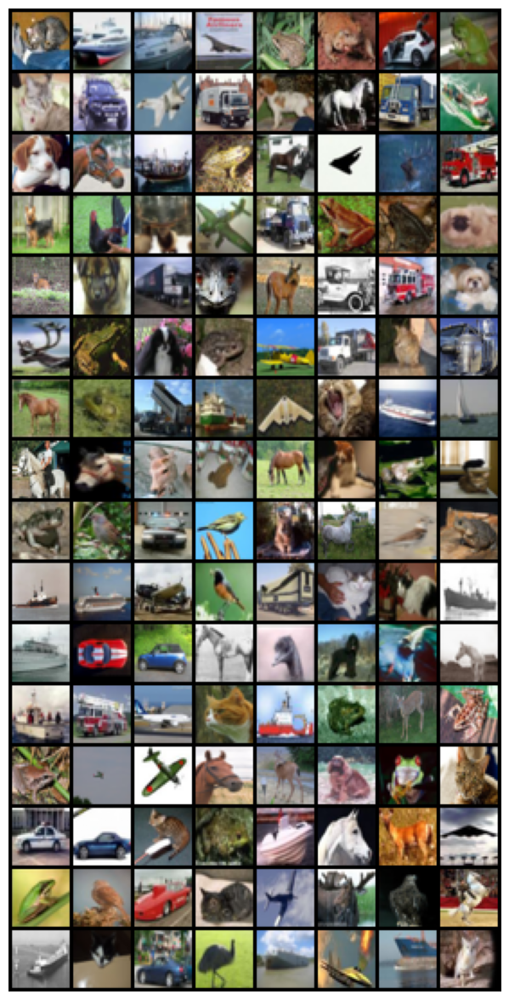

In [25]:
samples, _ = next(iter(loader_test))

samples = samples.cpu()
samples = make_grid(denorm(samples), nrow=8, padding=2, normalize=False,
                        value_range=None, scale_each=False, pad_value=0)
plt.figure(figsize = (15,15))
plt.axis('off')
show(samples)

#### Model Definition
Define hyperparameters and the model

In [26]:
# *CODE FOR PART 2.1 IN THIS CELL*

# Choose the number of epochs, the learning rate
# and the size of the Generator's input noise vetor.

num_epochs = 100
learning_rate = 0.0002
latent_vector_size = 100

# Other hyperparams
out_channels = 3 # RGB, cannot be changed
dropout_prob = 0.2
channel_variable = 32 # channel_variable convolutional layers

In [27]:
# *CODE FOR PART 2.1 IN THIS CELL*
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.generate = nn.Sequential(
            nn.ConvTranspose2d( latent_vector_size, channel_variable * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(channel_variable * 16),
            nn.ReLU(True),
            nn.ConvTranspose2d(channel_variable * 16, channel_variable * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(channel_variable * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d( channel_variable * 8, channel_variable * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(channel_variable * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(channel_variable * 4, out_channels, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    # You can modify the arguments of this function if needed
    def forward(self, z):
        out = self.generate(z)
        return out


class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.discriminate = nn.Sequential(
            nn.Conv2d(out_channels, channel_variable*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(channel_variable*4),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_prob),
            nn.Conv2d(channel_variable*4, channel_variable*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(channel_variable*8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_prob),
            nn.Conv2d(channel_variable*8, channel_variable * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(channel_variable*16),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_prob),
            nn.Conv2d(channel_variable*16, channel_variable * 32, 4, 2, 1, bias=False),
            nn.BatchNorm2d(channel_variable*32),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_prob),
            nn.Conv2d(channel_variable*32, channel_variable * 64, 2, 1, 1, bias=False),
            nn.BatchNorm2d(channel_variable*64),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout(dropout_prob),
            nn.Conv2d(channel_variable*64, 1, 3, 1, 0, bias=False),
            nn.Sigmoid()
        )
        
    # You can modify the arguments of this function if needed
    def forward(self, x):
        out = self.discriminate(x)
        return out


<h2> Initialize Model and print number of parameters </h2>

You can use method `weights_init` to initialize the weights of the Generator and Discriminator networks. Otherwise, implement your own initialization, or do not use at all. You will not be penalized for not using initialization.

In [28]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)

In [29]:
use_weights_init = True

model_G = Generator().to(device)
if use_weights_init:
    model_G.apply(weights_init)
params_G = sum(p.numel() for p in model_G.parameters() if p.requires_grad)
print("Total number of parameters in Generator is: {}".format(params_G))
print(model_G)
print('\n')

model_D = Discriminator().to(device)
if use_weights_init:
    model_D.apply(weights_init)
params_D = sum(p.numel() for p in model_D.parameters() if p.requires_grad)
print("Total number of parameters in Discriminator is: {}".format(params_D))
print(model_D)
print('\n')

print("Total number of parameters is: {}".format(params_G + params_D))

Total number of parameters in Generator is: 3448576
Generator(
  (generate): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): Tanh()
  )
)


Total number of parameters in Discriminator is: 19431168
Discriminator(
  (discriminate): Sequential(
    (0): Conv2d(3, 128, kernel_size=(4, 4), stride=(2, 2

### Part 2.1b: Training the Model (12 Points)

#### Defining a Loss

In [30]:
# You can modify the arguments of this function if needed
def loss_function(out, true_label):
    loss_funct = nn.BCELoss(reduction="mean") # initialise loss functon
    loss = loss_funct(out, true_label) # calculate loss
    return loss

<h3>Choose and initialize optimizers</h3>

In [31]:
# setup optimizer
# You are free to add a scheduler or change the optimizer if you want. We chose one for you for simplicity.
beta1 = 0.5
optimizerD = torch.optim.Adam(model_D.parameters(), lr=learning_rate, betas=(beta1, 0.999))
optimizerG = torch.optim.Adam(model_G.parameters(), lr=learning_rate, betas=(beta1, 0.999))


<h3> Define fixed input vectors to monitor training and mode collapse. </h3>

In [32]:
fixed_noise = torch.randn(batch_size, latent_vector_size, 1, 1, device=device)
# Additional input variables should be defined here

# One sided label smoothing
real_label = .9
fake_label = 0

#### Training Loop

Complete the training loop below. We've defined some variables to keep track of things during training:
* errD: Loss of Discriminator after being trained on real and fake instances
* errG: Loss of Generator
* D_x: Output of Discriminator for real images
* D_G_z1: Output of Discriminator for fake images (When Generator is not being trained)
* D_G_z2: Output of Discriminator for fake images (When Generator is being trained)

In [33]:
train_losses_G = []
train_losses_D = []

# <- You may wish to add logging info here
# Double check current hyperparams
print(f"num_epochs = {num_epochs}")
print(f"learning_rate = {learning_rate}")
print(f"latent_vector_size = {latent_vector_size}")

print(f"out_channels = {out_channels}")
print(f"dropout_prob = {dropout_prob}")
print(f"channel_variable = {channel_variable}")

print(f"real label = {real_label}")
print(f"real label = {fake_label}")


for epoch in range(num_epochs):
    # <- You may wish to add logging info here
    train_loss_D = 0
    train_loss_G = 0
    with tqdm.tqdm(loader_train, unit="batch") as tepoch:
        for i, data in enumerate(tepoch):

            ### First, update discriminator by maximising log(D(x)) + log(1 - D(G(z))) (Binary Cross Entropy)
            model_D.zero_grad()
            
            # Format batch
            real_cpu = data[0].to(device)
            b_size = real_cpu.size(0)
            label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
            
            # Forward pass real batch 
            output = model_D(real_cpu)
            output = output.view(-1)

            # Calculate loss on all-real batch
            errD_real = loss_function(output, label)
            errD_real.backward() # Calculate gradients for D in backward pass
            D_x = output.mean().item()
            
            # Generate batch of latent vectors to produce fake images
            noise = torch.randn(b_size, latent_vector_size, 1, 1, device=device)
            
            # Generate fake image batch
            fake = model_G(noise)
            label.fill_(fake_label)
            
            # Classify all of fake batch
            output = model_D(fake.detach()).view(-1)
            
            # Calculate D's loss on the all-fake batch
            errD_fake = loss_function(output, label)
            errD_fake.backward() # Calculate the gradients for this batchas the sum with previous gradients
            D_G_z1 = output.mean().item()
            
            # Compute total error as sum over the fake and the real batches
            errD = errD_real + errD_fake
            train_loss_D += errD.item()
            optimizerD.step() # update

            ### (2) Update G network: maximize log(D(G(z)))
            model_G.zero_grad()
            label.fill_(real_label)  # fake labels are real for generator cost
            
            # Since we just updated D, perform another forward pass of all-fake batch through D
            output = model_D(fake).view(-1)
            
            # Calculate G's loss based on this output
            errG = loss_function(output, label)
            train_loss_G += errG.item()
            
            # Calculate gradients for G
            errG.backward()
            D_G_z2 = output.mean().item()
            optimizerG.step() # update

            # Logging 
            if i % 50 == 0:
                tepoch.set_description(f"Epoch {epoch}")
                tepoch.set_postfix(D_G_z=f"{D_G_z1:.3f}/{D_G_z2:.3f}", D_x=D_x,
                                  Loss_D=errD.item(), Loss_G=errG.item())

    if epoch == 0:
        save_image(denorm(real_cpu.cpu()).float(), content_path/'CW_GAN/real_samples.png')
    with torch.no_grad():
        fake = model_G(fixed_noise)
        save_image(denorm(fake.cpu()).float(), str(content_path/'CW_GAN/fake_samples_epoch_%03d.png') % epoch)
    train_losses_D.append(train_loss_D / len(loader_train))
    train_losses_G.append(train_loss_G / len(loader_train))
    
# save  models 
# if your discriminator/generator are conditional you'll want to change the inputs here
torch.jit.save(torch.jit.trace(model_G, (fixed_noise)), content_path/'CW_GAN/GAN_G_model.pth')
torch.jit.save(torch.jit.trace(model_D, (fake)), content_path/'CW_GAN/GAN_D_model.pth')

torch.save(model_G, '/vol/bitbucket/kh123/dl-cw2/CW_GAN/GAN_G_model.pt')
torch.save(model_D, '/vol/bitbucket/kh123/dl-cw2/CW_GAN/GAN_D_model.pt')



num_epochs = 100
learning_rate = 0.0002
latent_vector_size = 100
out_channels = 3
dropout_prob = 0.2
channel_variable = 32
real label = 0.9
real label = 0


Epoch 0:   1%|          | 8/782 [00:00<01:01, 12.55batch/s, D_G_z=0.627/0.000, D_x=0.597, Loss_D=2.27, Loss_G=17.3]

Epoch 99: 100%|██████████| 782/782 [01:02<00:00, 12.42batch/s, D_G_z=0.014/0.007, D_x=0.941, Loss_D=0.361, Loss_G=4.61]
/vol/bitbucket/kh123/dl-cw2/venv/lib/python3.10/site-packages/torch/jit/_trace.py:1102: TracerWarning: Output nr 1. of the traced function does not match the corresponding output of the Python function. Detailed error:
Tensor-likes are not close!

Mismatched elements: 128 / 128 (100.0%)
Greatest absolute difference: 0.06547682359814644 at index (120, 0, 0, 0) (up to 1e-05 allowed)
Greatest relative difference: 16.224202747602906 at index (70, 0, 0, 0) (up to 1e-05 allowed)
  _check_trace(


In [34]:
# convert loss list to dataframe 
dataframe = pd.DataFrame({
    'Generator Loss': train_losses_G,
    'Discriminator Loss': train_losses_D
})

# ensure current directoty and save dataframe as csv
current_directory = os.getcwd()
print("Current directory:", current_directory)
dataframe.to_csv(f'CW_GAN/Loss Curves/loss curves for 5th iteration.csv', index=False)

Current directory: /vol/bitbucket/kh123/dl-cw2


## Part 2.1c: Results (10 Points)
This part is fairly open-ended, but not worth too much so do not go crazy. The table below shows examples of what are considered good samples. Level 3 and above will get you 10/10 points, level 2 will roughly get you 5/10 points and level 1 and below will get you 0/10 points.

<table><tr>
<td> 
  <p align="center">
    <img alt="Routing" src="https://drive.google.com/uc?id=18aWqRAnAVTRDY52y1yHSCdqSxUFRKOS9" width="%30">
    <br>
    <em style="color: grey">Level 1</em>
  </p> 
</td>
<td> 
  <p align="center">
    <img alt="Routing" src="https://drive.google.com/uc?id=1ymO2-jGAvWeUR2kaj_LxQcGYF1RWNRnw" width="%30">
    <br>
    <em style="color: grey">Level 2</em>
  </p> 
</td>
<td> 
  <p align="center">
    <img alt="Routing" src="https://drive.google.com/uc?id=13SW62ekW32NMYtfcdm_dCJJ3ZMOZEZAJ" width="%30">
    <br>
    <em style="color: grey">Level 3</em>
  </p> 
</td>
</tr></table>

### Generator samples

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Current directory: /vol/bitbucket/kh123/dl-cw2


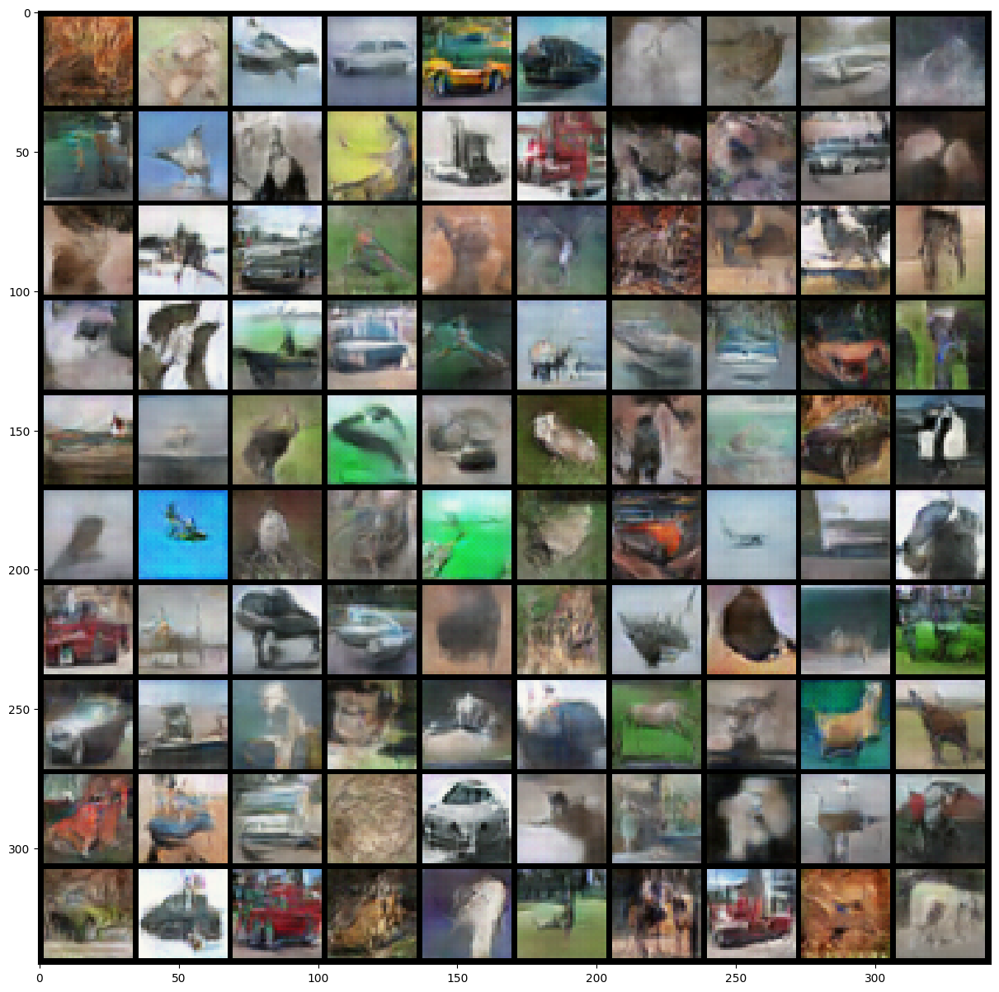

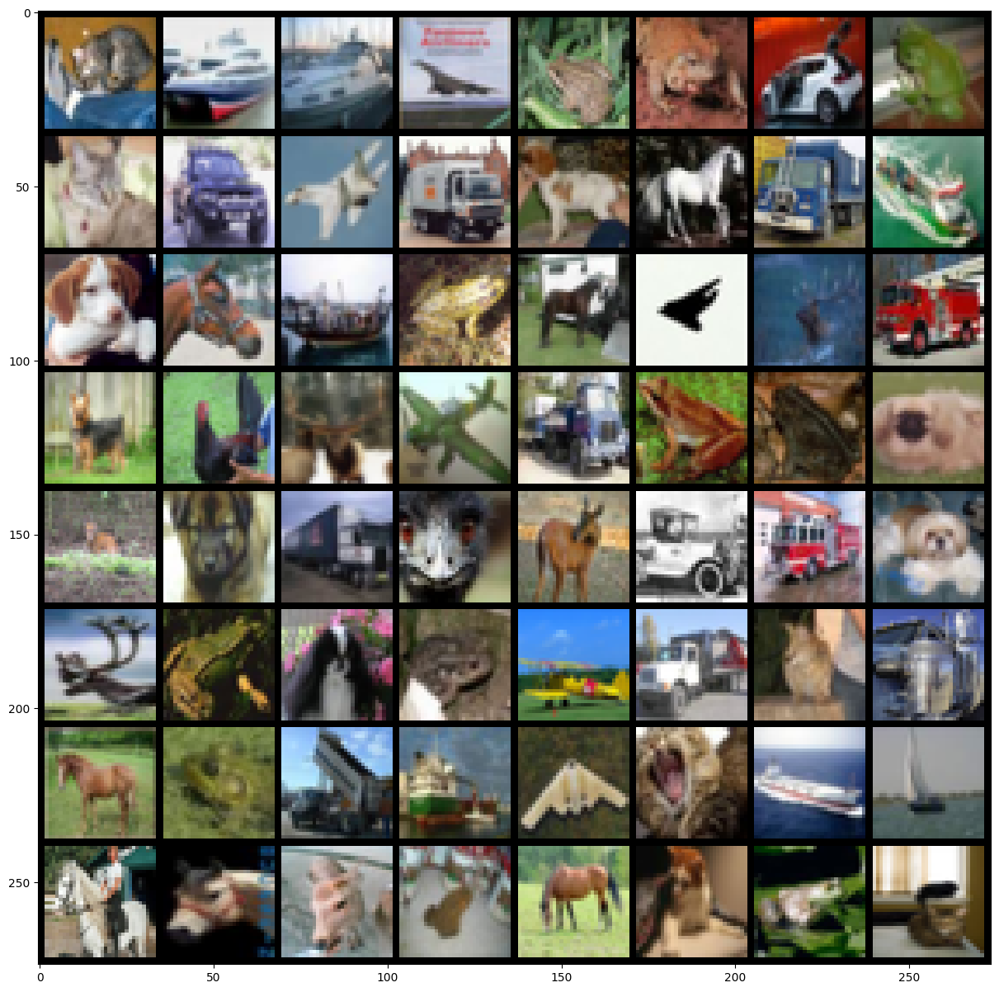

In [35]:
input_noise = torch.randn(100, latent_vector_size, 1, 1, device=device)
with torch.no_grad():
    # visualize the generated images
    generated = model_G(input_noise).cpu()
    generated = make_grid(denorm(generated)[:100], nrow=10, padding=2, normalize=False, 
                        value_range=None, scale_each=False, pad_value=0)
    plt.figure(figsize=(15,15))
    current_directory = os.getcwd()
    print("Current directory:", current_directory)
    save_image(generated,'CW_GAN/Teaching_final.png')
    show(generated) # note these are now class conditional images columns rep classes 1-10

it = iter(loader_test)
sample_inputs, _ = next(it)
fixed_input = sample_inputs[0:64, :, :, :]
# visualize the original images of the last batch of the test set for comparison
img = make_grid(denorm(fixed_input), nrow=8, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure(figsize=(15,15))
show(img)

## Part 2.1d: Engineering Choices (10 Points)

Discuss the process you took to arrive at your final architecture. This should include:

* Which empirically useful methods did you utilize
* What didn't work, what worked and what mattered most
* Are there any tricks you came across in the literature etc. which you suspect would be helpful here

**Your Answer**

**Initial Architecture:**

The final architecture was achieved by first using the provided literature from Radford et al., incorporating as many similarities to their model as possible. The similarities that persist in the final architecture are:
-	The removal of any fully connected networks
-	The removal of pooling layers, instead using strided convolutions
-	The use of BatchNorm whenever possible
-	ReLu activations for hidden layers in the generator 
-	Tanh activation for the final layer of the generator
-	Leaky ReLu for the hidden layers in the discriminator

While many features were kept, the number of layers in the generator was reduced from 4 to 3 to reflect the requirements of our specific task: generating 32 x 32 images instead of 64 x 64. In the original paper, the 100-dimensional “z” feature space is projected to a 1024 x 4 x 4 feature map. Here, the same “z” vector (100D) is instead mapped to a 512 x 4 x 4 feature space. 

While the above features did make it into the final architecture, they were still modified to see if an improvement could be observed. Instead of strided convolutions, pooling layers (like max-pooling and standard upsampling) were tested, resulting in a noticeable drop in performance. This is likely due to the generator and discriminator losing the ability to learn their own spatial up-sampling and down-sampling, instead using deterministic pooling functions. 

Activation functions for hidden layers inside the generator, replacing ReLu, were also tested, but mostly resulted in decreased performance again. Activation functions that resulted in poorer performance were sigmoid and tanh, but the leaky ReLu function performed approximately the same. As there was no noticeable difference between ReLu and Leaky ReLu, ReLu was kept as suggested by the literature. 

The use of BatchNorm was also reduced for initial tests, resulting in low variance of images and eventually mode collapse. This is in agreement with GAN literature, stating that a lack of variance can cause GAN generators to collapse all samples to a single point. On the other hand, additional application of BatchNorm to the final layers also resulted in poorly generated images and instability. Ultimately, BatchNorm was applied as suggested by the literature: only in the hidden layers. 

**Architecture Improvements (empirically useful methods and what worked)**

Through empirical trials, some improvements to the initial architecture were also found. These improvements include:
-	Increasing variance for normalisation of input data 
-	Adding horizontally flipped images to the dataset
-	Adding more layers to the discriminator
-	One-sided label smoothing
-	Adding Dropout
-	Increasing the number of epochs

Before increasing the standard deviation for the normalisation transformation applied to the dataset (pre-processing), generated images were drab and less coloured in comparison to the actual data samples. This was mostly corrected by increasing the standard deviation, effectively changing the colour and contrast of the training data (pre-processing). The resultant images become much more vibrant and similar to the real samples.

Another pre-processing improvement included doubling the training set through the addition of horizontally flipped images. By flipping images horizontally, the dataset can be synthetically increased while adding only realistic images, unlike vertically flipped or colour-augmented images. While technically still the same images, the flipped samples also introduce slightly more variety to the training data, allowing the GAN to be trained on alternatively-facing objects instead of just objects that are facing one way. As a result more realistic and distinctively recognisable images are produced after training with less invalid generations. However, it can be argued that the flipped images are too similar to the original data, and performance has increased due to essentially being trained on twice the number of epochs (equivalent to 200 epochs from 100 epochs). 

As there is a 25 million parameter limit for the GAN, increasing the complexity of the model was also pursued, specifically in the discriminator. The choice of exploring the discriminator stems mostly from its lack of detail in the provided literature (having more exploratory freedom) and other research that often points to discriminator-related issues in GANs (i.e. the overconfidence of discriminators). Improving the discriminator should also help the generator produce better results through its ability to detect fake images. Originally using 4 layers, 6 layers were eventually implemented, only increasing model parameters to approximately 22 million while greatly improving model performance.

Discriminator improvements also included one-sided label smoothing, where the positive class (real) is given a value of 0.9 instead of 1 and the negative class (fake) is kept at 0. This is incorporated because discriminators often suffer from overconfidence, labelling clearly fake images as real and resulting in a model that produces low-quality images that it thinks are good fakes (because it easily tricks the discriminator). By labeling real images as 0.9 instead, the discriminator does not reward low-quality fakes that managed to trick the discriminator as highly, encouraging the model to produce better and more diverse fakes in comparison to a training process that does not use label smoothing. This was also empirically shown as the resultant images of the final architecture were of higher quality and more diverse.

Dropout was also incorporated into the discriminator architecture, being mentioned in much of the GAN literature. By incorporating a low amount of dropout, variance during training is increased while overfitting is further prevented. Although not by much, this resulted in an improvement in output quality.

**What worked the most (Tricks found in Literature)**

From the initial architecture to all the improvements made, the most important aspects are as follows:
-	*Batch Normalisation*: 
    - Without it, the model quickly suffers from mode collapse. It is crucial in any architecture
-	*Increased variance*: 
    - Without this increase in training data normalisation, generated images were discoloured and drab, not resembling the vibrant colours of real samples. Increasing this variance immediately rectified this discolouration.
-	*One-sided Label Smoothing*: 
    - This increased the overall quality and diversity of the generated images, not allowing the generator to exploit low-quality images that fool the discriminator.
-	*Increasing the hidden layers of the discriminator*: 
    - The performance of the discriminator improved greatly, evidenced by its loss curves decreasing in magnitude. This in turn helped train the generator, improving the overall quality of its images.

**What didn’t work**

Through the many changes that were implemented and explored, some changes had either a negative effect or very little impact. These factors are:
-	*Increasing dropout*: 
    - While dropout probability values were explored, performance was never improved. After increasing the probability past a certain point (approximately 0.35), the generated images were severely impacted.
-	*Increasing the latent space*: 
    - An attempt was made to increase the latent space such that more information can be captured and fed to the generator. The result was negligible, with generated images having little differences while increasing computation times. 
-	*Increasing the hidden layer channel size*: 
    - As a hyperparameter, more channels were added to the hidden layers during convolution, hoping to be able to capture more relationships or latent features in a more complicated network. Again, there was little to no impact on the generated outputs, showing that building deeper networks is more beneficial than denser layers. 
-	*Tuning the learning rate*: 
    - The learning rate was briefly explored but resulted in instability during model training. As the literature-proposed 0.0002 provided good stability at reasonable convergence rates, it was kept. 
-	*Number of Epochs*: 
    - Arguably, the number of epochs is still very important as it cannot be unreasonably low (i.e. 1). However, the number of epochs was not a major factor when using the final architecture, as evidenced by both its plotted loss curves and generated samples at each epoch. While the loss curves are atypical, it can be seen that the model has practically reached convergence within just a few epochs and performance does not improve greatly over time. When looking at the generated samples (which is a more accurate method of analysis), high-quality images are already starting to be produced in as little as 10 epochs, mostly of horses and cars. 


## Part 2.2: Understanding GAN Training (5 points)


### Loss Curves
**Your task:**


Plot the losses curves for the discriminator $D$ and the generator $G$ as the training progresses and explain whether the produced curves are theoretically sensible and why this is (or not) the case (x-axis: epochs, y-axis: loss).

Make sure that the version of the notebook you deliver includes these results.

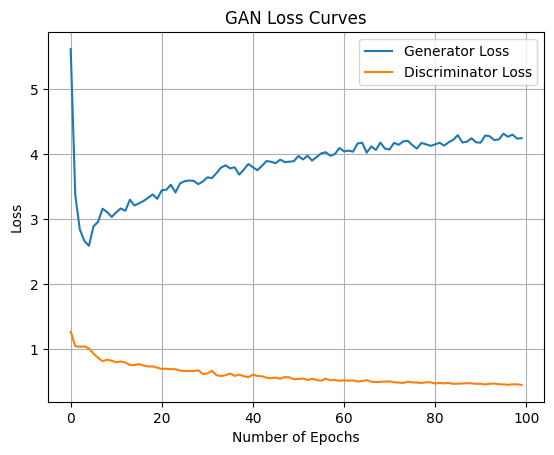

[5.623626972174706, 3.3758439539033738, 2.843388905610575, 2.6664649598738728, 2.5910281182631203, 2.8899169452202593, 2.961794820092523, 3.162269323911813, 3.110597553727267, 3.0363491862021443, 3.1075023263692856, 3.16696866695076, 3.1309118339091615, 3.3010714162341164, 3.2113584573845118, 3.2455679976269414, 3.2824909110432086, 3.3299487493836972, 3.3835281877185377, 3.3143516306758234, 3.446152683223605, 3.455152795671502, 3.5320470054893542, 3.412844679049214, 3.551567242654693, 3.5863120724325595, 3.5970803030464045, 3.590421503042931, 3.5409672201213325, 3.5800964411186134, 3.6460224359160494, 3.633445812575043, 3.7109974061360447, 3.795003547616627, 3.831597639928998, 3.7827924794858068, 3.8010859338523786, 3.6874209919853893, 3.764046745036569, 3.852033004202806, 3.801228374395224, 3.7555802348629594, 3.823660670720098, 3.8961628991014816, 3.8860859688742995, 3.8633145029892395, 3.9186102488004337, 3.8815404863461205, 3.8866714181192696, 3.8945513259419395, 3.9747807021107513

<Figure size 640x480 with 0 Axes>

In [36]:
# ANSWER FOR PART 2.2 IN THIS CELL*
x_values = list(range(num_epochs))
plt.plot(x_values, train_losses_G, label='Generator Loss')
plt.plot(x_values, train_losses_D, label='Discriminator Loss')
plt.title("GAN Loss Curves")
plt.ylabel("Loss")
plt.xlabel("Number of Epochs")
plt.legend()
plt.grid()
plt.show()
plt.savefig("GAN_training_curves/5th_iteration")

print(train_losses_G)

### Discussion

Do your loss curves look sensible? What would you expect to see and why?


**YOUR ANSWER**

To analyse the loss curves above, we can first establish what is expected. In a GAN, the generator and discriminator improve each other and therefore, their respective loss functions are inherently tied to the performance of the other. At first, the losses for both should be high, as neither have undergone enough training to have adequate performance. However, as the discriminator improves to detect fake images, the generator improves such that it can continue to fool the discriminator. Meanwhile, the generator’s improved images force the discriminator to improve as well, not allowing the discriminator to rely on features from obviously fake images. Theoretically, this adversarial style of improvement will eventually result in a convergence, where neither can continue to improve the other and further training epochs would have no effect. 

Within the plotted loss curves above, expected and unexpected features can be observed, but remain “sensible” within the context of our GAN understanding. It is also important to note that while the generator’s loss scale is higher than the discriminator’s, its relative performance of little significance. While the losses are not independent of each other, it’s more important to understand how the generator and discriminator affect one another instead of which one has the “better” loss.

As expected, both loss curves start high (relative to their scales), starting at their global maximums before quickly decreasing. These curves also have a slight noise, reflecting the adversarial nature of the GAN training process where an improvement of one component can lead to a worsened loss metric for the other. Furthermore, the discriminator loss continues to reduce throughout the epochs before eventually plateauing (signalling convergence)

Conversely, the generator loss does not follow expected trends, gradually increasing after its initial sharp decrease and signalling a lack of convergence. This is indicative of an imbalance in the generator-discriminator performance, where the discriminator has become too strong, and the generator is repeatedly penalised for its fake images. As training continues, the discriminator’s continued improvement is not only reflected in its own loss curve but also in the generator’s, causing it to increase. However, this relative performance of the generator is also the reason why images generated at epoch = 5 are far from ideal and are objectively worse than the final images produced at epoch = 100. This shows that while the generator’s relative performance worsens (loss curve), its absolute quality (judged qualitatively) can remain the same. 

While sub-optimal, the observed loss curves are “sensible”, being explainable and within our understanding of GANs. These results are more sensible when considering the GANs architecture, where the discriminator has 6 layers compared to the generator’s 4, also having 19 million parameters to the generator’s 3 million. As such, future improvements include strengthening the generator, adding complexity through added depth or tuning learning rate/optimiser hyperparameters. Conversely, slightly weakening the discriminator could be explored as well. 

## Part 2.3: Understanding Mode Collapse (5 points) 
**Your task:**
 
Describe the what causes the phenomenon of Mode Collapse and how it may manifest in the samples from a GAN. 

Based on the images created by your generator using the `fixed_noise` vector during training, did you notice any mode collapse? what this behaviour may be attributed to, and what did you try to eliminate / reduce it?

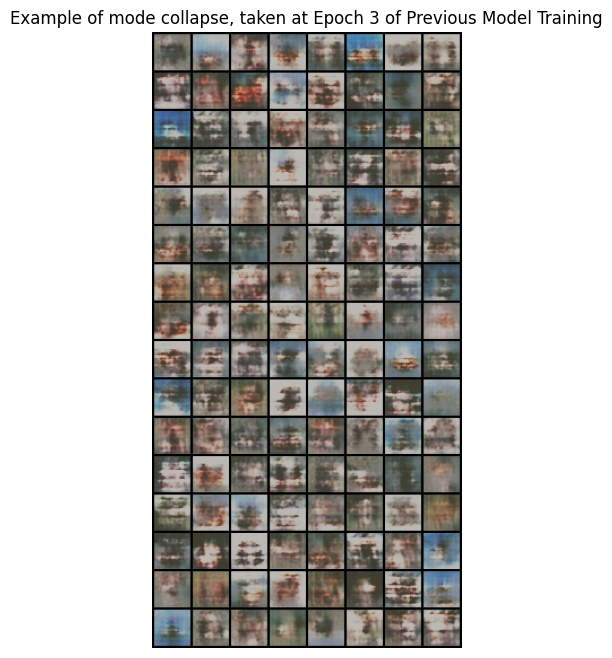

In [48]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

img = mpimg.imread('mode_collapse_example.png')
plt.figure(figsize=(8,8))
plt.imshow(img)
plt.title("Example of mode collapse, taken at Epoch 3 of Previous Model Training")
plt.axis('off')
plt.show()

### Discussion


**YOUR ANSWER**

**What is Mode Collapse and How it May Manifest**

In an ideal GAN, the generator should produce a diverse range of outputs covering the various modes (i.e., distinct categories or types) of the training data. However, in mode collapse, the generator starts producing a limited variety of outputs as a result of its training process. Its manifestation is always reflective of its failure to capture the full diversity of the training data, resulting in any of the following: repetitive outputs, a loss of detail, ignoring input noise, unstable training metrics, or failure to capture specific data subgroups. More specifically, it is often observed that noticeable patterns (like checkerboard patterns) emerge, arising from generators taking shortcuts to produce images that are visually convincing but lack true variety.

**Mode Collapse during Training**

While not prevalent, this can be seen in the early stages of a previous model’s training process, pictured above. In these generated images, the model has produced many images at resemble a checkered or spotted brown-white pattern, reflective of mode collapse. This phenomenon can be caused by a variety of issues, including a lack of diversity in training data, an overpowering discriminator, non-ideal loss functions, and inadequate model capacity (further described below). 

**Causes of Mode Collapse and Their Level of Attribution to Observed Samples**

-	The most obvious reason for a lack of diversity in generated outputs would be a parallel lack of diversity in the training data. Like any machine learning model (not only generative ones), GANs are highly dependent on the quality of training data, assuming that input samples it will see in production will be similar to the distribution seen during training. Regarding our GAN training, the CIFAR-10 dataset is highly diverse and large, making a “lack of diversity” an unlikely reason for the observed mode collapse. 
-	Another obvious reason could be a lack of complexity in the generator, placing an innate limit on model performance. Insufficient model complexity would not allow the generator to capture the complex relationships within the data. Even if the model could understand some relationships and patterns, it could learn to only replicate a subset of training data effectively, reducing its output diversity.
-	Conversely, a non-obvious, GAN-inherent reason for mode collapse would be an over-performing discriminator, overpowering the generator during training. While a strong discriminator forces the generator to improve its image quality, an overpowering discriminator counterintuitively forces the generator to exploit the few images that have managed to fool the discriminator. As the generator is not often successful, its successful images are low in diversity, resulting in mode collapse. When considering the loss curves of the previous model (similar to that of the final model), an overpowering discriminator is the most likely reason for the observed mode collapse. 
-	Additionally, the nature of the loss functions themselves can contribute to mode collapse. In loss functions like the ones used in our final GAN, the diversity of outputs is not considered. Instead, loss functions primarily focus on fooling the discriminator, leading to a generator that produces similar outputs but still ultimately deceives the discriminator. As such, this likely another contributing factor the mode collapse observed above.

**Techniques to Prevent or Eliminate Mode Collapse**

During training, mode collapse was rarely observed and if so, only at the early stages of training (epochs less than 10). However, this was likely due to the architectural and engineering choices established at the beginning of training, along with some minor improvements along the way.

-	*Complex generator architecture*: From the first iteration of training, the generator architecture was sufficiently complex to capture many complex relationships in the data, utilising multiple “deconvolution” layers with BatchNorm. 
-	*Increased variation during pre-processing normalisation*: While the data from CIFAR-10 is already diverse, increased variation during pre-processing normalisation helped decrease the severity of mode collapse. Before increasing the standard deviation, output images were drab and less diverse in colour, even in the final GAN outputs after training was completed. By increasing the variance of the input data, the diversity also increased, mitigating mode collapse effects.
-	*Data augmentation*: The training dataset was also augmented through horizontal flipping, synthetically increasing the variety of the dataset. Therefore, the variety of the outputs also improved. 

In addition to the techniques employed, further techniques include:

-	*Balanced training*: Maintaining balanced strength between the generator and the discriminator ensures that an overpowering discriminator is not produced. This can be done by adjusting respective learning rates or model complexities. 
-	*Regularisation*: Specifically targeting the lack of diversity, regularisation can be employed to account for variety during training. This can be done through mini-batch discrimination, involving additional features that describe a mini-batches diversity and feeding them to the discriminator. This helps penalise the generator if it repeatedly outputs similar samples
-	*Advanced model architectures*: Specifically designed for better training stability and resistance, some architectures like Wasserstein GANs or Conditional GANs can be used. in WGANs, a Wasserstein loss function is used that provides better convergence properties that help mitigate mode collapse. In conditional GANs, additional information (usually class labels) can help generate more diverse outputs by providing more guidance instead of trying to produce images from random noise. 




# TA Test Cell
TAs will run this cell to ensure that your results are reproducible, and that your models have been defined suitably. 

<font color="orange"> <b> Please provide the input and output transformations required to make your VAE and GANs work. If your GAN generator requires more than just noise as input, also specify this below (there are two marked cells for you to inspect) </b></font>


In [29]:
# If you want to run these tests yourself, change directory:
# %cd '.../dl_cw2/'
ta_data_path = "../data" # You can change this to = data_path when testing

In [30]:
!pip install -q torch torchvision

In [31]:
# Do not remove anything here
import os
import numpy as np
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, sampler
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
import torch.nn.functional as F
import matplotlib.pyplot as plt 

show = lambda img: plt.imshow(np.transpose(img.cpu().numpy(), (1,2,0)))

device = torch.device("cuda"  if torch.cuda.is_available() else "cpu")

# Do not change this cell!
torch.backends.cudnn.deterministic = True
torch.manual_seed(0)

In [32]:
############# CHANGE THESE (COPY AND PASTE FROM YOUR OWN CODE) #############
vae_transform = transforms.Compose([
    transforms.ToTensor(),
])

def vae_denorm(x):
    return x

mean = torch.Tensor([0.4914, 0.4822, 0.4465])
std = torch.Tensor([0.5, 0.5, 0.5])
unnormalize = transforms.Normalize((-mean / std).tolist(), (1.0 / std).tolist())

def gan_denorm(x, channels=None, w=None ,h=None, resize = False):
    
    x = unnormalize(x)
    if resize:
        if channels is None or w is None or h is None:
            print('Number of channels, width and height must be provided for resize.')
        x = x.view(x.size(0), channels, w, h)
    return x

gan_latent_size = 100

# If your generator requires something other than noise as input, please specify
# two cells down from here

In [33]:
# Load VAE Dataset
test_dat = datasets.MNIST(ta_data_path, train=False, transform=vae_transform, 
                          download=True)
vae_loader_test = DataLoader(test_dat, batch_size=32, shuffle=False)

In [34]:
############# MODIFY IF NEEDED #############
vae_input, _ = next(iter(vae_loader_test))

# If your generator is conditional, then please modify this input suitably
input_noise = torch.randn(100, gan_latent_size, 1, 1, device=device)
gan_input = [input_noise] # In case you want to provide a tuple, we wrap ours

Used CNN


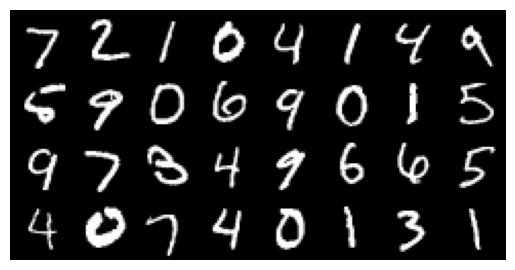

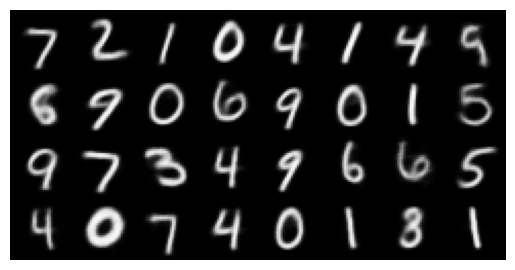

In [41]:
# VAE Tests
# TAs will change these paths as you will have provided the model files manually
"""To TAs, you should have been creating a folder with the student uid
   And the .ipynb + models in the root. Then that path is './VAE_model.pth' etc.
"""
vae = model_G = torch.jit.load('./VAE_model.pth')
vae.eval()

# Check if VAE is convolutional
def recurse_cnn_check(parent, flag):
    if flag:
        return flag
    children = list(parent.children())
    if len(children) > 0:
        for child in children:
            flag = flag or recurse_cnn_check(child, flag)
    else:
        params = parent._parameters
        if 'weight' in params.keys():
            flag = params['weight'].ndim == 4
    return flag

has_cnn = recurse_cnn_check(vae, False)
print("Used CNN" if has_cnn else "Didn't Use CNN")

vae_in = make_grid(vae_denorm(vae_input), nrow=8, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure()
plt.axis('off')
show(vae_in)

vae_test = vae(vae_input.to(device))[0].detach()
vae_reco = make_grid(vae_denorm(vae_test), nrow=8, padding=2, normalize=False,
                value_range=None, scale_each=False, pad_value=0)
plt.figure()
plt.axis('off')
show(vae_reco)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Number of Parameters is 22879744 which is ok


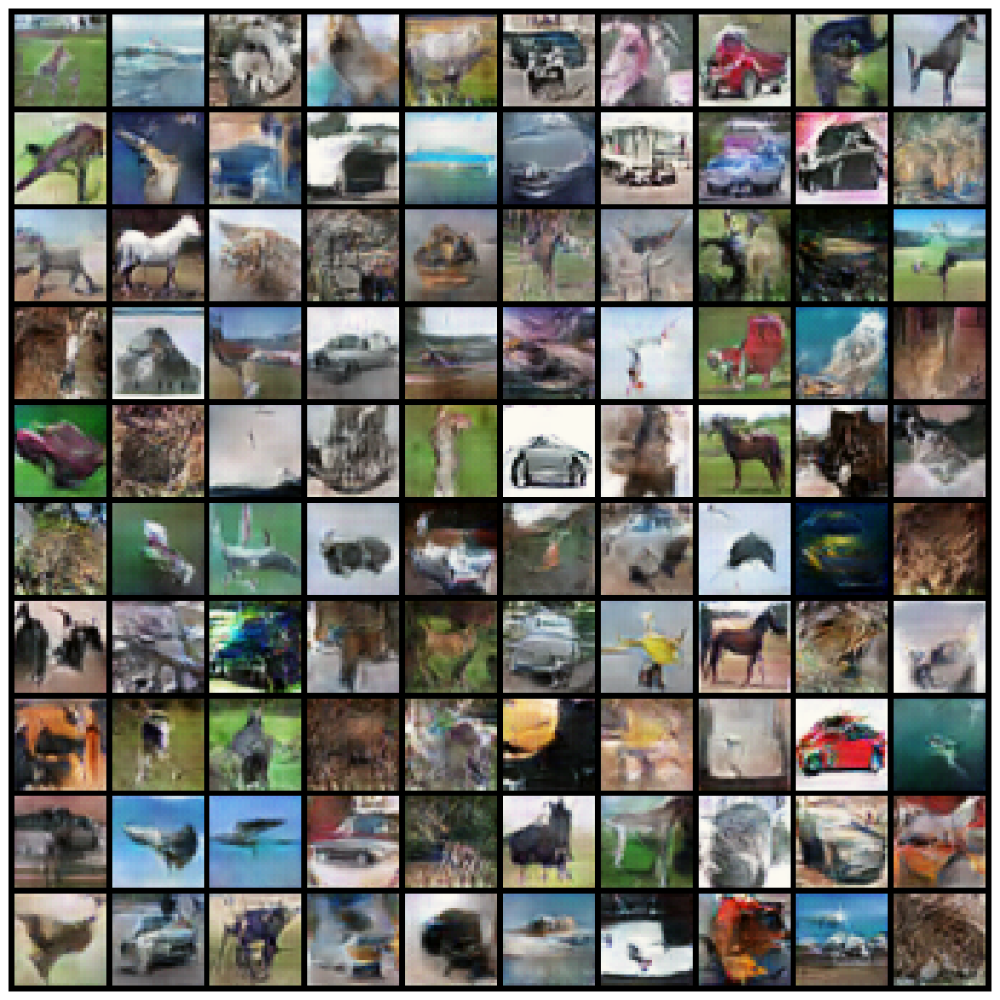

In [42]:
# GAN Tests
model_G = torch.jit.load('./GAN_G_model.pth')
model_D = torch.jit.load('./GAN_D_model.pth')
[model.eval() for model in (model_G, model_D)]  

# Check that GAN doesn't have too many parameters
num_param = sum(p.numel() for p in [*model_G.parameters(),*model_D.parameters()])

print(f"Number of Parameters is {num_param} which is", "ok" if num_param<25E+6 else "not ok")

# visualize the generated images
generated = model_G(*gan_input).cpu()
generated = make_grid(gan_denorm(generated)[:100].detach(), nrow=10, padding=2, normalize=False, 
                    value_range=None, scale_each=False, pad_value=0)
plt.figure(figsize=(15,15))
plt.axis('off')
show(generated)